In [1]:
!pip install setuptools


In [2]:
cd C:\Users\wm6\actt\src


C:\Users\wm6\actt\src


In [3]:
!python setup.py develop


running develop
running egg_info
writing CAN_objects.egg-info\PKG-INFO
writing dependency_links to CAN_objects.egg-info\dependency_links.txt
writing top-level names to CAN_objects.egg-info\top_level.txt
reading manifest file 'CAN_objects.egg-info\SOURCES.txt'
writing manifest file 'CAN_objects.egg-info\SOURCES.txt'
running build_ext
Creating c:\users\wm6\appdata\local\miniconda3\envs\srpgnn\lib\site-packages\CAN-objects.egg-link (link to .)
CAN-objects 0.4.0 is already the active version in easy-install.pth

Installed c:\users\wm6\actt\src
Processing dependencies for CAN-objects==0.4.0
Finished processing dependencies for CAN-objects==0.4.0


C:\Users\wm6\AppData\Local\miniconda3\envs\srpgnn\Lib\site-packages\setuptools\command\develop.py:40: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        See https://github.com/pypa/setuptools/issues/917 for details.
        ********************************************************************************

!!
  easy_install.initialize_options(self)
C:\Users\wm6\AppData\Local\miniconda3\envs\srpgnn\Lib\site-packages\setuptools\_distutils\cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer, pypa/build o

In [4]:
!pip install bitstring
!pip install seaborn
!pip install cantools
import os 
import sys
import numpy as np
from collections import defaultdict
import CAN_objects.aid_message
import matplotlib.pyplot as plt
%matplotlib inline
from generalFunctions import unpickle
import subprocess

import importlib
importlib.reload(CAN_objects.aid_message)

<module 'CAN_objects.aid_message' from 'C:\\Users\\wm6\\actt\\src\\CAN_objects\\aid_message.py'>

In [5]:
import os
import sys

sys.path.insert(0, os.path.dirname(os.getcwd()) + "/code/")
!pip install opencv-python
!pip install helper_functions
import helper_functions
!pip install networkx
import networkx

!pip install tqdm
from tqdm import tqdm

import numpy as np
import pandas as pd
from scipy.integrate import quad

import matplotlib.pyplot as plt
%matplotlib inline

import json
import fnmatch
import scipy

!pip install scikit-learn
from sklearn.metrics import auc
from sklearn.covariance import EllipticEnvelope


In [6]:
# path for log file 'C:\Users\wm6\Dropbox\cant2can-ldrd\can-data\open_dataset_logs\road\ambient'
file = 'C:\\Users\\wm6\\Dropbox\\cant2can-ldrd\\can-data\\open_dataset_logs\\road\\ambient\\ambient_dyno_drive_basic_long.log'

### Calling out make_can_df

In [7]:
def make_can_df(log_filepath):

    can_df = pd.read_fwf(
        log_filepath, delimiter = ' '+ '#' + '('+')',
        skiprows = 1,skipfooter=1,
        usecols = [0,2,3],
        dtype = {0:'float64', 1:str, 2: str},
        names = ['time','pid', 'data'] )

    can_df.pid = can_df.pid.apply(lambda x: int(x,16))
    can_df.data = can_df.data.apply(lambda x: x.zfill(16)) #pad with 0s on the left for data with dlc < 8
    can_df.time = can_df.time - can_df.time.min()
    return can_df[can_df.pid<=0x700]

In [8]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df(file)
df

,time,pid,data
0,0.000000,813,0000042758010000
1,0.001019,1694,0440047E1FC01542
2,0.001020,293,9000401F41BE7960
3,0.002916,737,0000000000000004
4,0.003937,852,1FFF40000003B680
...,...,...,...
2991265,1250.942507,1505,893FE00B0A000080
2991266,1250.942508,1413,0040000000020018
2991267,1250.943525,51,0007A0000E0007D0
2991268,1250.943526,628,00F208F7107C81DD


In [9]:
# Sort the DataFrame based on the 'time' column
df_sorted = df.sort_values('time')

# Format the 'time' values to two decimal points
df_sorted['time'] = df_sorted['time'].round(2)

# Print the new sorted DataFrame
print(df_sorted)

            time   pid              data
0           0.00   813  0000042758010000
1           0.00  1694  0440047E1FC01542
2           0.00   293  9000401F41BE7960
3           0.00   737  0000000000000004
4           0.00   852  1FFF40000003B680
...          ...   ...               ...
2991265  1250.94  1505  893FE00B0A000080
2991266  1250.94  1413  0040000000020018
2991267  1250.94    51  0007A0000E0007D0
2991268  1250.94   628  00F208F7107C81DD
2991269  1250.94   263  0000000000000000

[2802431 rows x 3 columns]


In [10]:
# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df_sorted['time'].max() / time_slice_duration) + 1

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df_sorted[(df_sorted['time'] > start_time) & (df_sorted['time'] <= end_time)]
    print(f"{time_slice_label}\n{time_slice_df}\n")


Time Slice 1: (0.0, 10.0]
        time   pid              data
9       0.01  1255  0000001703520000
10      0.01   339  00000004000C0004
12      0.01   661  0000000000000840
13      0.01  1634  4F20000040000000
14      0.01  1668  54D580194147501E
...      ...   ...               ...
23919  10.00   737  0000000000000004
23920  10.00   852  1FF1C0000005A280
23921  10.00  1505  893FE00B0A016480
23922  10.00   354  00080593EA11F4CE
23923  10.00   167  0010FA69512820A0

[22405 rows x 3 columns]

Time Slice 2: (10.0, 20.0]
        time   pid              data
23924  10.01  1255  0000001703520000
23925  10.01   339  00000000000C000A
23927  10.01  1634  4F20000040000000
23928  10.01  1668  54D580194147501E
23929  10.01  1590  24760000EE8A8000
...      ...   ...               ...
47834  20.00   737  0000000000000004
47835  20.00   852  1FE2400000075680
47836  20.00  1505  893FE00B0A00B480
47837  20.00   354  000802D3EA11F4CE
47838  20.00   167  0010FAE9512820A0

[22405 rows x 3 columns]

Time 

Time Slice 28: (270.0, 280.0]
          time   pid              data
645659  270.01   339  00000000000C000A
645661  270.01   661  0000000000001840
645662  270.01  1634  4F00000040000000
645663  270.01  1668  54D680194147901E
645664  270.01  1590  24760000EE88E000
...        ...   ...               ...
669560  280.00   470  020B808030206080
669562  280.00  1760  0C490C340C370C3A
669563  280.00   813  0000042758010000
669564  280.00    14  2060D602080977F2
669565  280.00  1255  0000001703520000

[22397 rows x 3 columns]

Time Slice 29: (280.0, 290.0]
          time   pid              data
669566  280.01   339  00000000000C000A
669568  280.01  1634  4F00000040000000
669569  280.01  1668  54D680194147901E
669570  280.01  1590  24760000EE824000
669571  280.01   727  100060D800000008
...        ...   ...               ...
693468  290.00  1760  0E9B0E8A0EA00EA3
693469  290.00   813  0000042758010000
693470  290.00  1413  0040000000020018
693471  290.00    14  205F960208097AEC
693473  290.00  

Time Slice 57: (560.0, 570.0]
           time   pid              data
1339022  560.01   628  00F202FC107C85BB
1339023  560.01   192  2000000000000000
1339024  560.01   996  00CC000005000000
1339025  560.01   813  0000042758010000
1339026  560.01  1644  0080100018000020
...         ...   ...               ...
1362925  570.00  1668  50D779594165901E
1362926  570.00  1590  2476C700F00D7000
1362927  570.00   727  100060D800000008
1362928  570.00   412  14F61FFEC2002920
1362929  570.00   208  527C0C60FA04F400

[22398 rows x 3 columns]

Time Slice 58: (570.0, 580.0]
           time   pid              data
1362930  570.01    51  000790000E8007D0
1362931  570.01   628  00F20AF4107C85D3
1362932  570.01   192  2000000000000000
1362933  570.01  1644  0080100018000020
1362934  570.01   996  00CC000005000000
...         ...   ...               ...
1386831  580.00   339  00000004000C0004
1386833  580.00  1634  4F80000040000000
1386834  580.00  1668  50D779594165901E
1386835  580.00  1590  2476C700F0

Time Slice 73: (720.0, 730.0]
           time   pid              data
1721668  720.01   412  05001FFF82002920
1721669  720.01   208  125F046261039600
1721670  720.01    51  1187D1198C8007D0
1721671  720.01   628  58F202FA107C8DD9
1721672  720.01   192  6000000000000000
...         ...   ...               ...
1745583  730.00   339  00000000000C000A
1745585  730.00  1505  892AA0070A02C080
1745586  730.00  1634  4F00000040000000
1745587  730.00   293  900045DF4639EF60
1745588  730.00  1668  50D681994169101E

[22411 rows x 3 columns]

Time Slice 74: (730.0, 740.0]
           time   pid              data
1745589  730.01  1590  247621813F88C000
1745590  730.01   727  100060D800000008
1745591  730.01   412  1570202F42002920
1745592  730.01   208  52730462C7092200
1745593  730.01    51  1E10A9E2AE8DD7D0
...         ...   ...               ...
1769500  740.00  1505  893840070A013480
1769501  740.00  1634  4F00000040000000
1769502  740.00   293  9000461F4638DF60
1769503  740.00  1413  0040000000

Time Slice 103: (1020.0, 1030.0]
            time   pid              data
2439025  1020.01    51  0007D0000C8007D0
2439026  1020.01   628  00F202FA107C8E23
2439027  1020.01  1760  01A301A101AC01AC
2439028  1020.01   192  6000000000000000
2439029  1020.01   186  06980284100001E4
...          ...   ...               ...
2462927  1030.00  1694  0440047C1FC01522
2462928  1030.00   293  9000461F457A1160
2462929  1030.00   852  2018C0000000C200
2462930  1030.00  1505  8925600B0A01D080
2462931  1030.00   651  0000000000000000

[22397 rows x 3 columns]

Time Slice 104: (1030.0, 1040.0]
            time   pid              data
2462932  1030.01   208  527C046451049D00
2462933  1030.01    51  000468000E8657D0
2462934  1030.01   628  00F20AF2107C8DD5
2462935  1030.01  1760  0409040A04030404
2462936  1030.01   192  6000000000000000
...          ...   ...               ...
2486835  1040.00  1505  891A200B0A007880
2486836  1040.00   651  0000000000000000
2486837  1040.00   208  127C046462089000
24868

Time Slice 118: (1170.0, 1180.0]
            time   pid              data
2797649  1170.01   186  06880284100001EC
2797650  1170.01   996  00E0000005000000
2797651  1170.01  1628  4009628800000002
2797652  1170.01  1399  000008000000013E
2797653  1170.01   293  9000499F47B71360
...          ...   ...               ...
2821559  1180.00    51  0004D0000C8607D0
2821560  1180.00   628  00F203F9107C8DCB
2821561  1180.00  1760  05D205CF05D205D1
2821562  1180.00   192  6000000000000000
2821563  1180.00   186  0698024410000214

[22405 rows x 3 columns]

Time Slice 119: (1180.0, 1190.0]
            time   pid              data
2821564  1180.01   996  00E0000005000000
2821565  1180.01  1628  4009738800000002
2821566  1180.01  1399  0000080000000140
2821567  1180.01   293  9000499F47B80360
2821568  1180.01   852  2024800000070E00
...          ...   ...               ...
2845462  1190.00   208  527B046098095100
2845463  1190.00    51  000448000E8697D0
2845464  1190.00   628  00F20AF2107C8DBF
28454

### Building graphs for each time window

C:\Users\wm6\AppData\Local\Temp\ipykernel_4628\2154935427.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


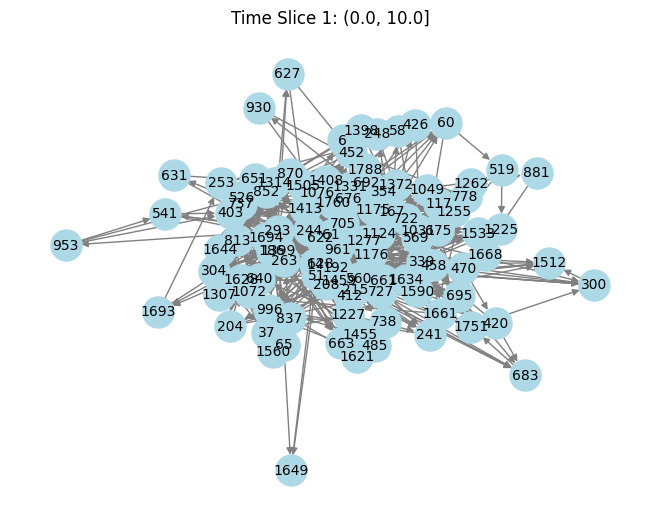

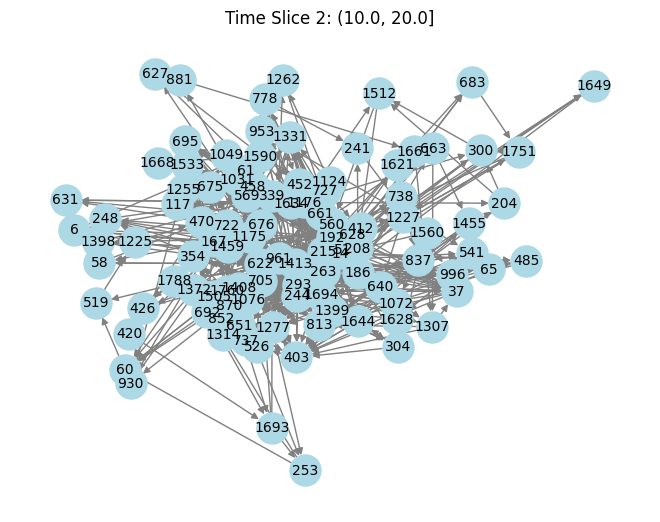

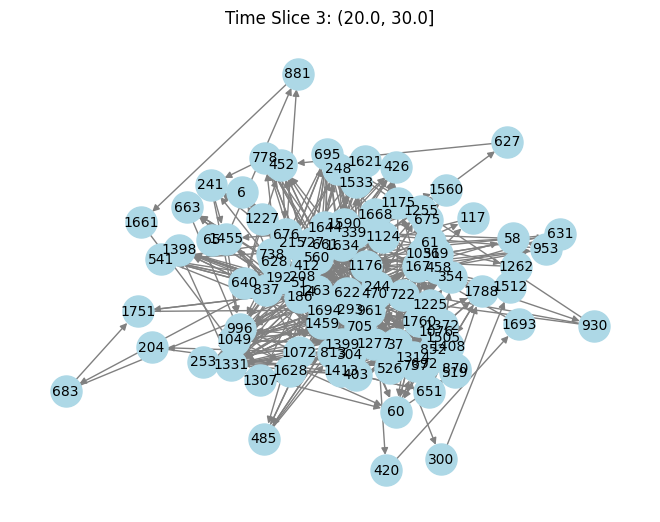

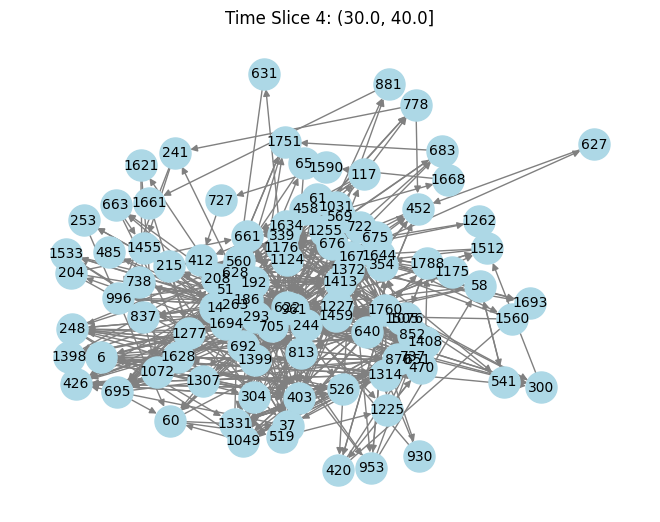

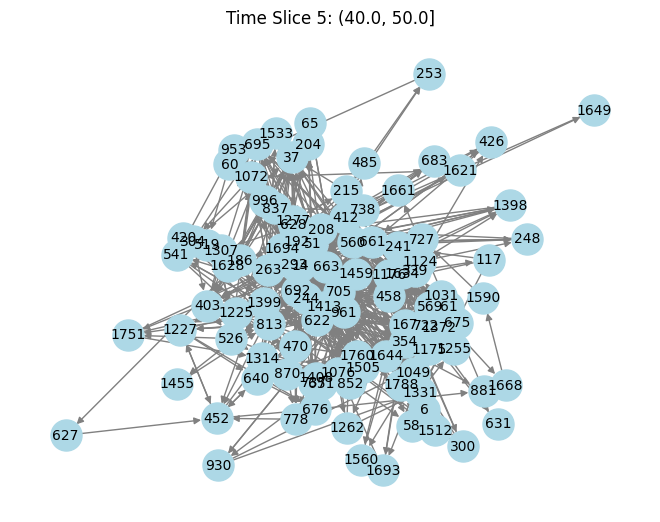

...

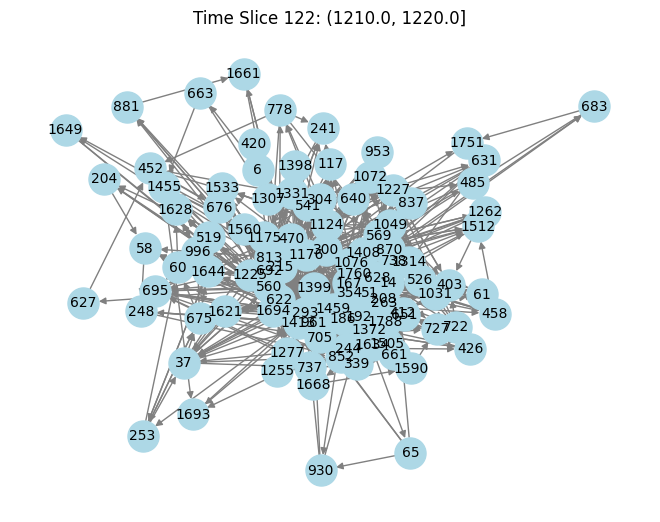

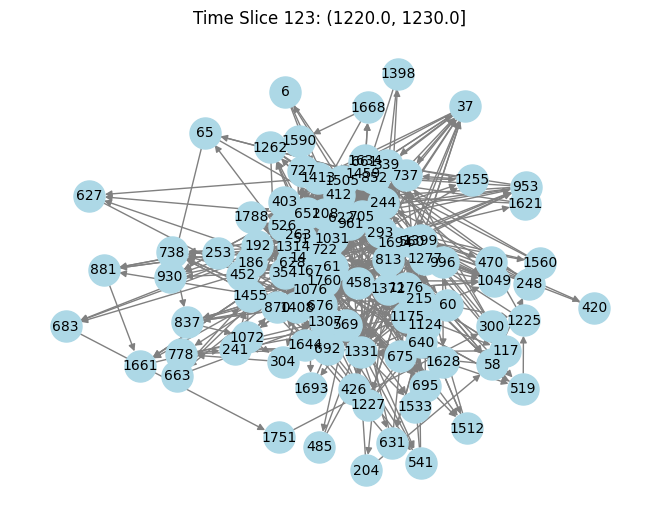

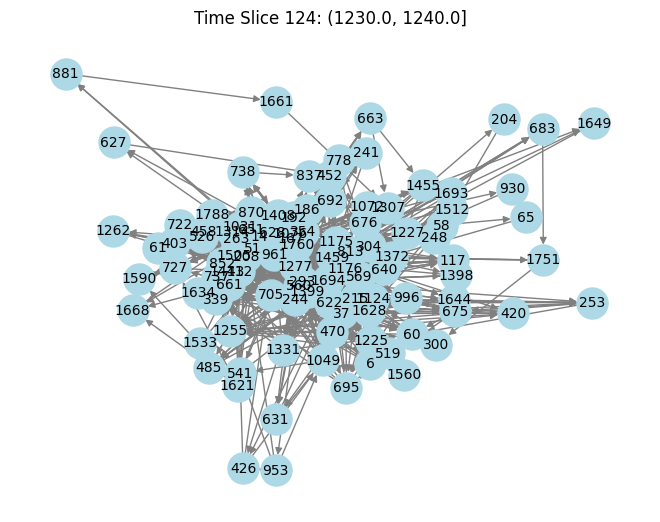

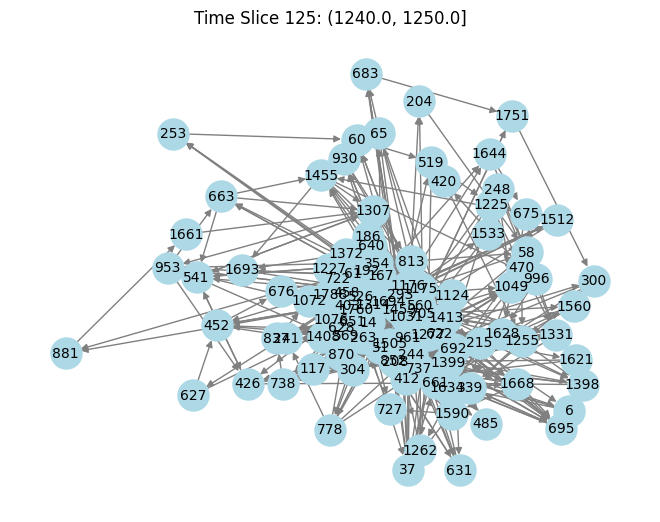

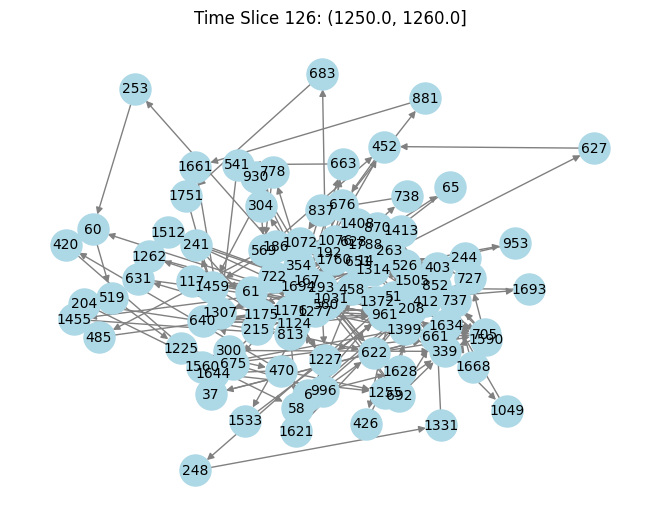

In [11]:
import networkx as nx
import matplotlib.pyplot as plt

# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j+1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Plot the graph
    plt.figure(i)
    nx.draw(G, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')
    plt.title(time_slice_label)

plt.show()


In [12]:
import os
from CAN_objects.capture import MappedCapture, MatchedCapture

In [13]:
cancap_filepath = os.path.join("C:\\Users\\wm6\\Dropbox\\data-cancaptures", "road_ambient_dyno_drive_basic_long_050305_002000", "capture.pkl")
cancap = unpickle(cancap_filepath)


In [14]:
ground_truth_dbc_fpath = os.path.join("C:\\Users\\wm6\\Dropbox\\data-cancaptures\\DBC", "anonymized_020822_030640.dbc")
mapped_capture = MappedCapture.init_from_dbc(cancap, ground_truth_dbc_fpath)

In [15]:
dir(mapped_capture)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid_list',
 'describe',
 'description',
 'end_datetime',
 'get_capture_path',
 'get_dsig_at_index',
 'get_elapsed_sec',
 'get_n_payloads',
 'get_n_signals',
 'has_aid_messages',
 'has_diagnostics',
 'init_from_dbc',
 'injection_aid',
 'injection_data_str',
 'injection_intervals',
 'injection_times',
 'jsonmyself',
 'mapped_payload_dict',
 'mode',
 'nonconstant_didxs',
 'picklemyself',
 'plot_diagnostic_signal_dict',
 'raw_candump_fpath',
 'start_datetime',
 'vehicle',
 'write_to_dbc']

In [16]:
 mapped_capture.has_diagnostics()

False

In [17]:
 mapped_capture.get_elapsed_sec()

1250.943529

In [18]:
 mapped_capture

road_ambient_dyno_drive_basic_long: None None None [03/05/05 00:20:00 - 03/05/05 00:40:50] Contains 664 mapped signals in 105 messages

In [19]:
mapped_capture.mapped_payload_dict

{6: 0 nonconstant bits: 3 Defined Signals,
 14: 23 nonconstant bits: 3 Defined Signals,
 37: 11 nonconstant bits: 4 Defined Signals,
 51: 54 nonconstant bits: 7 Defined Signals,
 58: 10 nonconstant bits: 1 Defined Signals,
 60: 6 nonconstant bits: 2 Defined Signals,
 61: 23 nonconstant bits: 5 Defined Signals,
 65: 0 nonconstant bits: 3 Defined Signals,
 117: 30 nonconstant bits: 3 Defined Signals,
 167: 33 nonconstant bits: 9 Defined Signals,
 186: 19 nonconstant bits: 8 Defined Signals,
 192: 2 nonconstant bits: 3 Defined Signals,
 204: 13 nonconstant bits: 8 Defined Signals,
 208: 37 nonconstant bits: 7 Defined Signals,
 215: 0 nonconstant bits: 5 Defined Signals,
 241: 24 nonconstant bits: 5 Defined Signals,
 244: 0 nonconstant bits: 4 Defined Signals,
 248: 0 nonconstant bits: 7 Defined Signals,
 253: 0 nonconstant bits: 2 Defined Signals,
 263: 0 nonconstant bits: 9 Defined Signals,
 293: 30 nonconstant bits: 7 Defined Signals,
 300: 0 nonconstant bits: 7 Defined Signals,
 304: 5

In [20]:
 mapped_capture.mapped_payload_dict.keys()

dict_keys([6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293, 300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627, 628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837, 852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255, 1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560, 1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788])

In [21]:
 dir(mapped_capture)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid_list',
 'describe',
 'description',
 'end_datetime',
 'get_capture_path',
 'get_dsig_at_index',
 'get_elapsed_sec',
 'get_n_payloads',
 'get_n_signals',
 'has_aid_messages',
 'has_diagnostics',
 'init_from_dbc',
 'injection_aid',
 'injection_data_str',
 'injection_intervals',
 'injection_times',
 'jsonmyself',
 'mapped_payload_dict',
 'mode',
 'nonconstant_didxs',
 'picklemyself',
 'plot_diagnostic_signal_dict',
 'raw_candump_fpath',
 'start_datetime',
 'vehicle',
 'write_to_dbc']

### Explore the Output for the IDS

In [22]:
 mp = mapped_capture.mapped_payload_dict[1760]

In [23]:
 dir(mp)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'aid',
 'const_0s',
 'const_1s',
 'display_payload_layout',
 'display_results',
 'get_borders_const_msk_list',
 'get_cuts',
 'get_known_bit_idxs',
 'get_message_bit_idx_lists',
 'get_message_bit_label_lists',
 'get_non_constant_bits',
 'get_transmission_rate',
 'get_transmission_rate_std',
 'get_unknown_bit_idxs',
 'init_from_cantools_dbc_message',
 'init_from_constant_delimeters',
 'name',
 'nonconst_bits',
 'payload_arr',
 'payload_layout',
 'plot_signals',
 'sending_ECU',
 'set_payload_layout',
 'signal_list',
 'times',
 'to_dbc_str',
 'unnest_signal_list',
 'update_bit_idxs']

### Time series plot

In [24]:
 mapped_capture.get_elapsed_sec()

1250.943529

In [25]:
mp.payload_arr.shape

(125094, 64)

In [26]:
 mp.get_transmission_rate()

0.01

In [27]:
 mp.sending_ECU

'X'

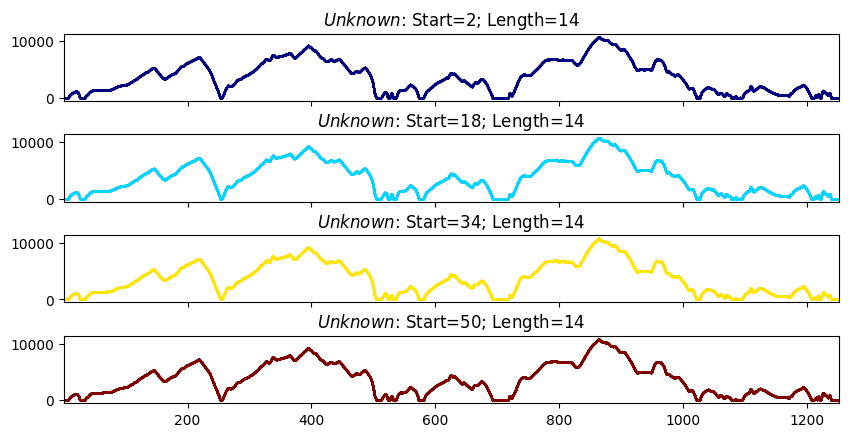

In [28]:
mp.plot_signals()

In [29]:
 mp.payload_arr

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [30]:
mp.payload_arr.shape

(125094, 64)

In [31]:
 mp.payload_arr.T[:, 910:920]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 0, 0, 0, 0, 0, 0, 1, 1, 1],
       [0, 0, 0, 0, 0, 1, 1, 0, 0, 0],
       [1, 0, 0, 1, 1, 1, 1, 0, 1, 1],
       [0, 1, 1, 1, 1, 0, 0, 1, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0,

In [32]:
display(mp.signal_list)
print(type(mp.signal_list[0]), len(mp.signal_list))

[Unknown_0 Start: 2; Length: 14,
 Unknown_1 Start: 18; Length: 14,
 Unknown_2 Start: 34; Length: 14,
 Unknown_3 Start: 50; Length: 14]

<class 'CAN_objects.signal.Signal'> 4


In [33]:
 s = mp.signal_list[0]
 s

Unknown_0 Start: 2; Length: 14

NoneType

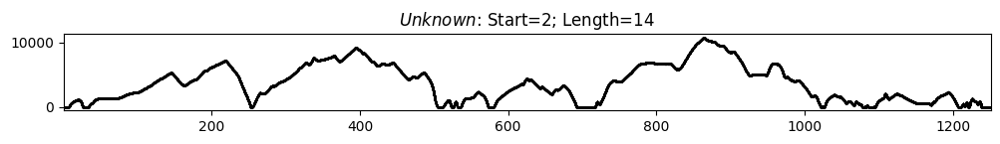

In [34]:
 type(s.plot())

In [35]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [36]:
 print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [37]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [38]:
 s.unit

''

In [39]:
 s= mp.signal_list[1]
 s


Unknown_1 Start: 18; Length: 14

NoneType

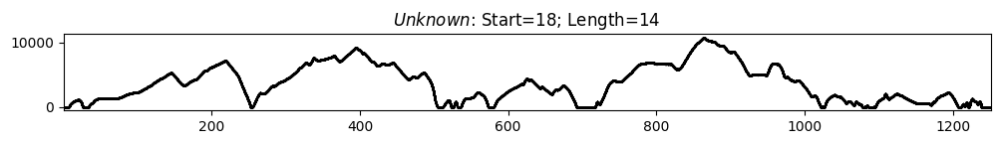

In [40]:

 type(s.plot())

In [41]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [42]:

print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [43]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [44]:
 s.unit

''

In [45]:
 s = mp.signal_list[2]
 s

Unknown_2 Start: 34; Length: 14

NoneType

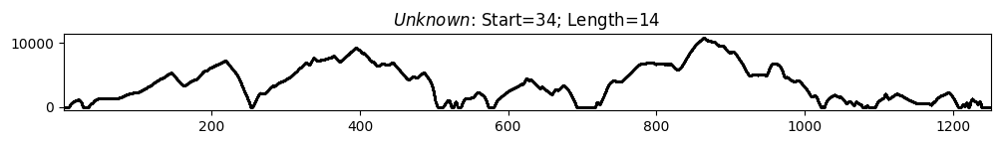

In [46]:
type(s.plot())

In [47]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [48]:
print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [49]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [50]:
 s = mp.signal_list[3]
 s

Unknown_3 Start: 50; Length: 14

NoneType

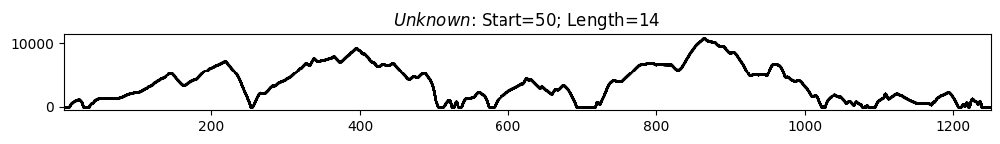

In [51]:
type(s.plot())

In [52]:
dir(s)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_handle_single_byte_little_endian',
 '_is_signed',
 '_set_ax',
 'a',
 'b',
 'binarray_to_int_vec',
 'byte_signal_list',
 'get_bit_idx_list',
 'get_bit_labels',
 'get_borders_const_msk',
 'get_first_bit',
 'get_last_bit',
 'get_little_endian_byte_signal_list',
 'get_lsb',
 'get_msb',
 'init_from_cantools_dbc_signal',
 'init_from_cantools_dbc_signal_filter',
 'is_little_endian',
 'is_matched',
 'is_signed',
 'length',
 'name',
 'plot',
 'pretty_print',
 'set_signal_values',
 'signal_binary_array',
 'start',
 'times',
 'unit',
 'update_tokenization',
 'values']

In [53]:
print(min(s.times), max(s.times))

0.003940105438232422 1250.9355700016022


In [54]:
 s.values

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [55]:
import pandas as pd

# Initialize lists to store the extracted data
signal_names = []
data_dict = {}

# Define the time windows (every 10 seconds)
time_windows = range(0, int(mp.times[-1]), 10)

# Loop through the signal_list and extract information for each time window
for window_start in time_windows:
    window_end = window_start + 10
    
    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
    
    for signal in mp.signal_list:
        # Get the indices for the current time window
        mask = (signal.times >= window_start) & (signal.times < window_end)
        
        # Get the values within the current time window and interpolate for consistent time resolution
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate().values
        
        # Add the interpolated signal values to the sub-DataFrame
        sub_df[signal.name] = interpolated_values[:10]  # Truncate to 10 samples if needed
    
    # Append the sub-DataFrame to the data dictionary with the window start as the key
    data_dict[f"{window_start} - {window_end}"] = sub_df

# Create a pandas DataFrame with the extracted data
df = pd.concat(data_dict, axis=1)

# Display the DataFrame
print(df)


     0 - 10                                 10 - 20                      \
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0         0         0         0         0       535       530       538   
1         0         0         0         0       534       532       538   
2         0         0         0         0       537       535       540   
3         0         0         0         0       537       535       542   
4         0         0         0         0       538       535       543   
5         0         0         0         0       541       532       543   
6         0         0         0         0       546       539       544   
7         0         0         0         0       546       542       545   
8         0         0         0         0       542       542       546   
9         0         0         0         0       540       542       546   

              20 - 30            ... 1220 - 1230           1230 - 1240  \
  Unknown_3 Unknown_0 Unk

### mean and sd for each signal per time window [mean,sd] for ID 1760

In [56]:
import pandas as pd

# Initialize lists to store the extracted data
signal_names = []
data_dict = {}

# Initialize a list to store the summary data for each time window
summary_data = []

# Define the time windows (every 10 seconds)
time_windows = range(0, int(mp.times[-1]), 10)

# Loop through the signal_list and extract information for each time window
for window_start in time_windows:
    window_end = window_start + 10
    
    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
    
    for signal in mp.signal_list:
        # Get the indices for the current time window
        mask = (signal.times >= window_start) & (signal.times < window_end)
        
        # Get the values within the current time window and interpolate for consistent time resolution
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate().values
        
        # Add the interpolated signal values to the sub-DataFrame
        sub_df[signal.name] = interpolated_values[:10]  # Truncate to 10 samples if needed
    
    # Calculate the mean and standard deviation for each signal in the current time window
    window_summary = []
    for signal_name in ["Unknown_0", "Unknown_1", "Unknown_2", "Unknown_3"]:
        mean_value = sub_df[signal_name].mean()
        std_value = sub_df[signal_name].std()
        # Round the standard deviation to two decimal places
        std_value = round(std_value, 2)
        window_summary.append([mean_value, std_value])
    
    # Append the window summary to the list
    summary_data.append({"Time Window": f"{window_start} - {window_end}", "Summary": window_summary})
    
    # Append the sub-DataFrame to the data dictionary with the window start as the key
    data_dict[f"{window_start} - {window_end}"] = sub_df

# Display the summary data
for window_data in summary_data:
    print(window_data["Time Window"])
    for i, signal_name in enumerate(["Unknown_0", "Unknown_1", "Unknown_2", "Unknown_3"]):
        mean_value, std_value = window_data["Summary"][i]
        print(f"{signal_name} [{mean_value}, {std_value}]")
    print()


0 - 10
Unknown_0 [0.0, 0.0]
Unknown_1 [0.0, 0.0]
Unknown_2 [0.0, 0.0]
Unknown_3 [0.0, 0.0]

10 - 20
Unknown_0 [539.6, 4.2]
Unknown_1 [536.4, 4.55]
Unknown_2 [542.5, 2.99]
Unknown_3 [541.9, 2.85]

20 - 30
Unknown_0 [1172.1, 4.23]
Unknown_1 [1166.6, 3.27]
Unknown_2 [1163.3, 1.06]
Unknown_3 [1162.3, 1.42]

30 - 40
Unknown_0 [0.0, 0.0]
Unknown_1 [0.0, 0.0]
Unknown_2 [0.0, 0.0]
Unknown_3 [0.0, 0.0]

40 - 50
Unknown_0 [780.1, 4.58]
Unknown_1 [776.1, 3.35]
Unknown_2 [795.2, 5.35]
Unknown_3 [794.9, 5.36]

50 - 60
Unknown_0 [1329.6, 3.31]
Unknown_1 [1324.7, 2.95]
Unknown_2 [1330.4, 1.17]
Unknown_3 [1328.7, 0.82]

60 - 70
Unknown_0 [1345.2, 4.08]
Unknown_1 [1340.0, 2.4]
Unknown_2 [1341.4, 1.51]
Unknown_3 [1340.5, 1.96]

70 - 80
Unknown_0 [1399.1, 3.6]
Unknown_1 [1394.0, 1.94]
Unknown_2 [1410.6, 0.97]
Unknown_3 [1409.6, 1.71]

80 - 90
Unknown_0 [1648.4, 6.87]
Unknown_1 [1643.1, 3.78]
Unknown_2 [1650.9, 0.88]
Unknown_3 [1651.2, 1.14]

90 - 100
Unknown_0 [2110.0, 3.16]
Unknown_1 [2103.0, 2.62]
Unkn

### Exploring all IDS, signals and their signal values

In [57]:
# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]
    
    # Display the information about the ID and its signals
    print(f"Exploring ID: {id_to_explore}")
    print(f"Number of nonconstant bits: {len(mp.signal_list)}")
    for signal in mp.signal_list:
        print(f"Signal: {signal.name}, Start: {signal.start}, Length: {signal.length}")
        print(f"Signal values: {signal.values}")
    print()


Exploring ID: 6
Number of nonconstant bits: 3
Signal: Unknown_0, Start: 4, Length: 1
Signal values: [1 1 1 ... 1 1 1]
Signal: Unknown_1, Start: 25, Length: 2
Signal values: [3 3 3 ... 3 3 3]
Signal: Unknown_2, Start: 29, Length: 1
Signal values: [1 1 1 ... 1 1 1]

Exploring ID: 14
Number of nonconstant bits: 3
Signal: Unknown_0, Start: 10, Length: 8
Signal values: [148 148 148 ... 133 133 133]
Signal: Unknown_1, Start: 47, Length: 1
Signal values: [1 1 1 ... 1 1 1]
Signal: Unknown_2, Start: 48, Length: 15
Signal values: [15026 15023 15029 ... 15011 15011 15011]

Exploring ID: 37
Number of nonconstant bits: 4
Signal: Unknown_0, Start: 18, Length: 9
Signal values: [20 20 20 ... 20 20 20]
Signal: Unknown_1, Start: 41, Length: 6
Signal values: [30 30 30 ... 32 32 32]
Signal: Unknown_2, Start: 47, Length: 8
Signal values: [66 67 67 ... 90 90 90]
Signal: Unknown_3, Start: 55, Length: 5
Signal values: [0 0 0 ... 0 0 0]

Exploring ID: 51
Number of nonconstant bits: 7
Signal: Unknown_0, Start: 

### Exploring all IDs,time windows,  signals and their signal values

In [58]:
import pandas as pd

# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]
    
    # Display the information about the ID and its signals
    print(f"Exploring ID: {id_to_explore}")
    print(f"Number of nonconstant bits: {len(mp.signal_list)}")
    
    # Initialize a dictionary to store the extracted data for each time window
    data_dict = {}
    
    # Define the time windows (every 10 seconds)
    time_windows = range(0, int(mp.times[-1]), 10)
    
    # Loop through the signal_list and extract information for each time window
    for window_start in time_windows:
        window_end = window_start + 10
        
        # Create a sub-DataFrame for the current time window
        sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window
        
        for signal in mp.signal_list:
            # Get the indices for the current time window
            mask = (signal.times >= window_start) & (signal.times < window_end)
            
            # Get the values within the current time window and interpolate for consistent time resolution
            signal_values = signal.values[mask]
            interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values
            
            # Ensure that interpolated values match the length of the DataFrame
            interpolated_values = [interpolated_values[i] if i < len(interpolated_values) else None for i in range(10)]
            interpolated_values = pd.Series(interpolated_values).interpolate(method='linear', limit_area='inside').values
            
            # Add the interpolated signal values to the sub-DataFrame
            sub_df[signal.name] = interpolated_values
        
        # Append the sub-DataFrame to the data_dict with the window start as the key
        data_dict[(window_start, window_end)] = sub_df
    
    # Create a pandas DataFrame with the extracted data for the current ID
    df = pd.concat(data_dict, axis=1)
    
    # Convert columns to a regular Index with tuples representing the time windows and signal names
    df.columns = pd.MultiIndex.from_tuples(df.columns)
    
    # Display the DataFrame for the current ID
    print(df)
    print()


Exploring ID: 6
Number of nonconstant bits: 3
       0                             10                            20    \
       10                            20                            30     
  Unknown_0 Unknown_1 Unknown_2 Unknown_0 Unknown_1 Unknown_2 Unknown_0   
0         1         3         1         1         3         1         1   
1         1         3         1         1         3         1         1   
2         1         3         1         1         3         1         1   
3         1         3         1         1         3         1         1   
4         1         3         1         1         3         1         1   
5         1         3         1         1         3         1         1   
6         1         3         1         1         3         1         1   
7         1         3         1         1         3         1         1   
8         1         3         1         1         3         1         1   
9         1         3         1         1         3   

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0        -6         0         3         2         0       125   
1         0        -7         0         3         3         0       125   
2         0        -8         0         3         4         0       125   
3         0        -9         0         3         5         0       125   
4         0       -10         0         3         6         0       125   
5         0       -11         0         3         7         0       125   
6         0       -12         0         3         8         0       125   
7         0       -13         0         3         9         0       125   
8         0       -14         0         3        10         0       125   
9         0       -15         0         3        11         0       125   

       10               

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0         0       119         0         0         0        85       133   
1         0       119         0         0         0        89       134   
2         0       119         0         0         0        94       134   
3         0       119         0         0         0        99       134   
4         0       119         0         0         0       105       135   
5         0       119         0         0         0       110       135   
6         0       120         0         0         0       115       135   
7         0       120         0         0         0       119       135   
8         0       120         0         0         0       123       136   
9         0       120         0         0         0       125       136   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         0         0         0       500         0       663   
1         1         0         0         0       500         0       663   
2         1         0         0         0       500         0       663   
3         1         0         0         0       500         0       663   
4         1         0         0         0       500         0       663   
5         1         0         0         0       500         0       663   
6         1         0         0         0       500         0       663   
7         1         0         0         0       500         0       663   
8         1         0         0         0       500         0       663   
9         1         0         0         0       500         0       663   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         7       549         0         2         4        64       991   
1         7       550         0         2         4        64       991   
2         7       550         0         2         4        64       991   
3         7       550         0         2         4        64       991   
4         7       550         0         2         4        64       991   
5         7       551         0         2         4        64       991   
6         7       551         0         2         4        64       991   
7         7       551         0         2         4        64       991   
8         7       551         0         2         4        64       991   
9         7       552         0         2         4        64       991   

                 10     

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0        90       244        10       244         1        90       244   
1        90       244        10       244         1        90       244   
2        90       244        10       244         1        90       244   
3        90       244        10       244         1        90       244   
4        90       244        10       244         1        90       244   
5        90       244        10       244         1        90       244   
6        90       244        10       244         1        90       244   
7        90       244        10       244         1        90       244   
8        90       244        10       244         1        90       244   
9        90       244        10       244         1        90       244   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                        

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0         0       123         0         0         0         0         0   
1         0       123         0         0         0         0         0   
2         0       123         0         0         0         0         0   
3         0       123         0         0         0         0         0   
4         0       123         0         0         0         0         0   
5         0       123         0         0         0         0         0   
6         0       123         0         0         0         0         0   
7         0       123         0         0         0         0         0   
8         0       123         0         0         0         0         0   
9         0       123         0         0         0         0         0   

                        

       0                             10                            20    \
       10                            20                            30     
  Unknown_0 Unknown_1 Unknown_2 Unknown_0 Unknown_1 Unknown_2 Unknown_0   
0         0       134         1         0        93         1         0   
1         0       134         1         0        93         1         0   
2         0       134         1         0        93         1         0   
3         0       134         1         0        93         1         0   
4         0       134         1         0        93         1         0   
5         0       134         1         0        94         1         0   
6         0       134         1         0        93         1         0   
7         0       134         1         0        94         1         0   
8         0       134         1         0        94         1         0   
9         0       134         1         0        94         1         0   

                        

       0                                       10                        \
       10                                      20                         
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0         1         1         7         1         1         1         7   
1         1         1         7         1         1         1         7   
2         1         1         7         1         1         1         7   
3         1         1         7         1         1         1         7   
4         1         1         7         1         1         1         7   
5         1         1         7         1         1         1         7   
6         1         1         7         1         1         1         7   
7         1         1         7         1         1         1         7   
8         1         1         7         1         1         1         7   
9         1         1         7         1         1         1         7   

                 20     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         5         2         0         0         0   
1         0         0         7         2         1         0         0   
2         0         1         5         3         0         1         1   
3         0         0         7         2         1         0         0   
4         0         0         5         2         0         0         0   
5         0         0         7         2         1         0         0   
6         1         0         5         2         0         0         0   
7         0         0         7         2         1         0         0   
8         0         0         5         2         0         0         0   
9         0         0         7         2         1         0         0   

                        

       0                                       10                        \
       10                                      20                         
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_0 Unknown_1 Unknown_2   
0      2048         0       511       510      2049       614       511   
1      2048         0       511       510      2048       617       510   
2      2048         0       511       510      2048       620       510   
3      2047         0       510       510      2049       622       510   
4      2047         0       510       510      2049       626       509   
5      2048         0       511       510      2049       627       509   
6      2048         0       510       510      2048       630       509   
7      2048         0       510       510      2049       631       510   
8      2048         0       511       509      2049       632       511   
9      2048         0       511       510      2050       633       511   

                 20     

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0      1000         0         0       520         0      1000         0   
1      1000         0         0       520         0      1000         0   
2      1000         0         0       520         0      1000         0   
3      1000         0         0       520         0      1000         0   
4      1000         0         0       520         0       999         0   
5      1000         0         0       520         0       977         0   
6      1000         0         0       520         0       961         0   
7      1000         0         0       520         0       948         0   
8      1000         0         0       520         0       939         0   
9      1000         0         0       520         0       933         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0        15         1         1         0        -2   
1         0         0        15         1         2         0        -3   
2         0         0        15         1         3         0        -4   
3         0         0        15         1         4         0        -5   
4         0         0        15         1         5         0        -6   
5         0         0        15         1         6         0        -7   
6         0         0        15         1         7         0        -8   
7         0         0        15         1         0         0        -1   
8         0         0        15         1         1         0        -2   
9         0         0        15         1         2         0        -3   

                        

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                 40     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         0         0         0         0       511   
1         0         0         0         0         0         0       511   
2         0         0         0         0         0         0       511   
3         0         0         0         0         0         0       511   
4         0         0         0         0         0         0       511   
5         0         0         0         0         0         0       511   
6         0         0         0         0         0         0       511   
7         0         0         0         0         0         0       511   
8         0         0         0         0         0         0       511   
9         0         0         0         0         0         0       511   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0     18632         0         0         0         1         0   
1         0     18632         0         0         0         1         0   
2         0     18633         0         0         0         1         0   
3         0     18633         0         0         0         1         0   
4         0     18633         0         0         0         1         0   
5         0     18633         0         0         0         1         0   
6         0     18633         0         0         0         1         0   
7         0     18633         0         0         0         1         0   
8         0     18633         0         0         0         1         0   
9         0     18633         0         0         0         1         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0       240         1         3         6         0         0   
1         0       264         2         3         6         0         0   
2         0       264         3         3         6         0         0   
3         0       264         4         3         6         0         0   
4         0       242         5         3         6         0         0   
5         0         0         6         3         6         0         0   
6         0         0         7         3         6         0         0   
7         0         0         8         3         6         0         0   
8         0         0         9         3         6         0         0   
9         0         0        10         3         6         0         0   

                 10     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         3         1         0      -235         1       264   
1         0         3         1         0      -235         1       264   
2         0         3         1         0      -235         1       264   
3         0         3         1         0      -235         1       264   
4         0         3         1         0      -235         1       264   
5         0         3         1         0      -235         1       264   
6         0         3         1         0      -235         1       264   
7         0         3         1         0      -235         1       264   
8         0         3         1         0      -235         1       264   
9         0         3         1         0      -235         1       264   

       10               

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         0         4        -1         0         1        29   
1         1         0         4        -1         0         1        29   
2         1         0         4        -1         0         1        29   
3         1         0         4        -1         0         1        29   
4         1         0         4        -1         0         1        29   
5         1         0         4        -1         0         1        29   
6         1         0         4        -1         0         1        29   
7         1         0         4        -1         0         1        29   
8         1         0         4        -1         0         1        29   
9         1         0         4        -1         0         1        29   

       10               

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
1       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
2       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
3       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
4       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
5       0.0       4.0       0.0       0.0      17.0       1.0       0.0   
6       NaN       NaN       NaN       NaN       NaN       NaN       0.0   
7       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
8       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
9       NaN       NaN       NaN       NaN       NaN       NaN       NaN   

                        

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0        50         0         5         0         0        50         0   
1        50         0         5         0         0        50         0   
2        50         0         5         0         0        50         0   
3        50         0         5         0         0        50         0   
4        50         0         5         0         0        50         0   
5        50         0         5         0         0        50         0   
6        50         0         5         0         0        50         0   
7        50         0         5         0         0        50         0   
8        50         0         5         0         0        50         0   
9        50         0         5         0         0        50         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0       173         1         2      8567         0         0   
1         0       173         1         2      8567         0         0   
2         0       173         1         2      8567         0         0   
3         0       173         1         2      8567         0         0   
4         0       173         1         2      8567         0         0   
5         0       173         1         2      8567         0         0   
6         0       173         1         2      8567         0         0   
7         0       173         1         2      8567         0         0   
8         0       173         1         2      8567         0         0   
9         0       173         1         2      8567         0         0   

                 10     

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                 40     

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0        23        82        23        82        23        82        23   
1        23        82        23        82        23        82        23   
2        23        82        23        82        23        82        23   
3        23        82        23        82        23        82        23   
4        23        82        23        82        23        82        23   
5        23        82        23        82        23        82        23   
6        23        82        23        82        23        82        23   
7        23        82        23        82        23        82        23   
8        23        82        23        82        23        82        23   
9        23        82        23        82        23        82        23   

                 40     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         1         2         1         1         1    117306   
1         1         2        49         1         0         0    110985   
2         1         4         9         0         0         3     16129   
3         1         0        12         0         2         0     65832   
4         0         0         2         0         3         0    271667   
5         1         0        26         0         1         2    133554   
6         1         1         2         1         1         1    117306   
7         1         2        49         1         0         0    110985   
8         1         4         9         0         0         3     16129   
9         1         0        12         0         2         0     65832   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         2         0         8         5        12        12        -2   
1         2         0         8         5        12        12        -2   
2         2         0         8         5        12        12        -2   
3         2         0         8         5        12        12        -2   
4         2         0         8         5        12        12        -2   
5         2         0         8         5        12        12        -2   
6         2         0         8         5        12        12        -2   
7         2         0         8         5        12        12        -2   
8         2         0         8         5        12        12        -2   
9         2         0         8         5        12        12        -2   

                        

       0                             10                            20    \
       10                            20                            30     
  Unknown_0 Unknown_1 Unknown_2 Unknown_0 Unknown_1 Unknown_2 Unknown_0   
0       126         1     32768       122         5     32768       118   
1       125         2     32768       121         6     32768       117   
2       124         3     32768       120         7     32768       116   
3       123         4     32768       119         8     32768       115   
4       122         5     32768       118         9     32768       114   
5       121         6     32768       117        10     32768       113   
6       120         7     32768       116        11     32768       112   
7       119         8     32768       115        12     32768       127   
8       118         9     32768       114        13     32768       126   
9       117        10     32768       113        14     32768       125   

                        

       0                                                 10              \
       10                                                20               
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_0 Unknown_1   
0         0         0         0         0         0         0         0   
1         0         0         0         0         0         0         0   
2         0         0         0         0         0         0         0   
3         0         0         0         0         0         0         0   
4         0         0         0         0         0         0         0   
5         0         0         0         0         0         0         0   
6         0         0         0         0         0         0         0   
7         0         0         0         0         0         0         0   
8         0         0         0         0         0         0         0   
9         0         0         0         0         0         0         0   

                        

       0                   10                  20                  30    \
       10                  20                  30                  40     
  Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0 Unknown_1 Unknown_0   
0        -1         3         0         0        -1         3        -1   
1        -1         3         0         0        -1         3        -1   
2        -8         2        -1         3        -1         3        -1   
3        -1         3        -1         3        -1         3        -1   
4        -1         3        -1         3        -1         3        -1   
5        -1         3        -1         3        -1         3         0   
6        -1         3        -1         3         0         0         0   
7        -1         3        -1         3         0         0         0   
8        -1         3        -1         3         0         0        -1   
9        -1         3        -8         2         0         0        -1   

                 40     

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0        20         0         2         0         0        17         0   
1        21         0         2         0         0        17         0   
2        22         0         2         0         0        17         0   
3        23         0         2         0         0        17         0   
4        24         0         2         0         0        17         0   
5        25         0         2         0         0        17         0   
6        26         0         2         0         0        17         0   
7        27         0         2         0         0        17         0   
8        28         0         2         0         0        17         0   
9        29         0         2         0         0        17         0   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         1         0         0         0         1         4         0   
1         1         0         0         0         1         3         0   
2         1         0         0         0         1         3         0   
3         1         0         0         0         1         3         0   
4         1         0         0         0         1         4         0   
5         1         0         0         0         1         3         0   
6         1         0         0         0         1         4         0   
7         1         0         0         0         1         4         0   
8         1         0         0         0         1         4         0   
9         1         0         0         0         1         4         0   

                        

       0                                                           10    \
       10                                                          20     
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_0   
0        21       213       512         1       285        15        21   
1        21       213       512         1       285        15        21   
2        21       213       512         1       285        15        21   
3        21       213       512         1       285        15        21   
4        21       213       512         1       285        15        21   
5        21       213       512         1       285        15        21   
6        21       213       512         1       285        15        21   
7        21       213       512         1       285        15        21   
8        21       213       512         1       285        15        21   
9        21       213       512         1       285        15        21   

                        

       0                                                                 \
       10                                                                 
  Unknown_0 Unknown_1 Unknown_2 Unknown_3 Unknown_4 Unknown_5 Unknown_6   
0         0         0         1         0        27         0         0   
1         0         0         1         0        28         0         0   
2         0         0         1         0        29         0         0   
3         0         0         1         0        30         0         0   
4         0         0         1         0        31         0         0   
5         0         0         1         0        32         0         0   
6         0         0         1         0        33         0         0   
7         0         0         1         0        34         0         0   
8         0         0         1         0        35         0         0   
9         0         0         1         0        36         0         0   

                 10     

### Mean and std for each signal per time window [mean,sd] -----------for ALL IDs

In [59]:
import pandas as pd
import numpy as np

# List of IDs to explore
ids_to_explore = [6, 14, 37, 51, 58, 60, 61, 65, 117, 167, 186, 192, 204, 208, 215, 241, 244, 248, 253, 263, 293,
                  300, 304, 339, 354, 403, 412, 420, 426, 452, 458, 470, 485, 519, 526, 541, 560, 569, 622, 627,
                  628, 631, 640, 651, 661, 663, 675, 676, 683, 692, 695, 705, 722, 727, 737, 738, 778, 813, 837,
                  852, 870, 881, 930, 953, 961, 996, 1031, 1049, 1072, 1076, 1124, 1175, 1176, 1225, 1227, 1255,
                  1262, 1277, 1307, 1314, 1331, 1372, 1398, 1399, 1408, 1413, 1455, 1459, 1505, 1512, 1533, 1560,
                  1590, 1621, 1628, 1634, 1644, 1649, 1661, 1668, 1693, 1694, 1751, 1760, 1788]

# Function to extract mean and std for each column in a DataFrame
def extract_mean_std(df):
    return [df.mean().values, df.std().values]

# Loop through each ID and extract the signal values
for id_to_explore in ids_to_explore:
    mp = mapped_capture.mapped_payload_dict[id_to_explore]

    # Display the information about the ID and its signals
    print(f"ID {id_to_explore}")

    # Define the time windows (every 10 seconds)
    time_windows = range(0, int(mp.times[-1]), 10)

    # Loop through the signal_list and extract information for each time window
    for window_start in time_windows:
        window_end = window_start + 10
        print(f"{window_start} - {window_end}")

        # Create a sub-DataFrame for the current time window
        sub_df = pd.DataFrame(index=range(10))  # Assuming 10 samples in each time window

        for signal in mp.signal_list:
            # Get the indices for the current time window
            mask = (signal.times >= window_start) & (signal.times < window_end)

            # Get the values within the current time window and interpolate for consistent time resolution
            signal_values = signal.values[mask]
            interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values

            # Ensure that interpolated values match the length of the DataFrame
            interpolated_values = [interpolated_values[i] if i < len(interpolated_values) else None for i in range(10)]
            interpolated_values = pd.Series(interpolated_values).interpolate(method='linear', limit_area='inside').values

            # Add the interpolated signal values to the sub-DataFrame
            sub_df[signal.name] = interpolated_values

        # Compute the mean and std for the sub-DataFrame
        mean_std_array = extract_mean_std(sub_df)

        # Display the mean and std for each signal in the current time window
        for signal_name, (mean_val, std_val) in zip(sub_df.columns, zip(*mean_std_array)):
            print(f"{signal_name} [{mean_val:.2f}, {std_val:.2f}]")

        print()


ID 6
0 - 10
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

10 - 20
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

20 - 30
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

30 - 40
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

40 - 50
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

50 - 60
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

60 - 70
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

70 - 80
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

80 - 90
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

90 - 100
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

110 - 120
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]

120 - 130
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]

Unknown_0 [147.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15164.90, 8.57]

20 - 30
Unknown_0 [146.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15163.30, 4.35]

30 - 40
Unknown_0 [148.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15022.10, 2.02]

40 - 50
Unknown_0 [145.30, 0.48]
Unknown_1 [1.00, 0.00]
Unknown_2 [15251.40, 5.06]

50 - 60
Unknown_0 [146.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15140.50, 2.92]

60 - 70
Unknown_0 [146.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15155.20, 2.90]

70 - 80
Unknown_0 [145.50, 0.53]
Unknown_1 [1.00, 0.00]
Unknown_2 [15148.60, 2.76]

80 - 90
Unknown_0 [143.80, 0.42]
Unknown_1 [1.00, 0.00]
Unknown_2 [15296.10, 2.33]

90 - 100
Unknown_0 [143.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15309.40, 2.37]

100 - 110
Unknown_0 [142.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15297.50, 5.44]

110 - 120
Unknown_0 [139.70, 0.48]
Unknown_1 [1.00, 0.00]
Unknown_2 [15464.70, 8.01]

120 - 130
Unknown_0 [132.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [16065.70, 

Unknown_0 [135.20, 0.42]
Unknown_1 [1.00, 0.00]
Unknown_2 [15001.50, 11.76]

1080 - 1090
Unknown_0 [135.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15035.30, 4.11]

1090 - 1100
Unknown_0 [135.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15017.00, 2.45]

1100 - 1110
Unknown_0 [132.20, 0.42]
Unknown_1 [1.00, 0.00]
Unknown_2 [15245.40, 2.37]

1110 - 1120
Unknown_0 [137.50, 1.27]
Unknown_1 [1.00, 0.00]
Unknown_2 [14700.10, 131.48]

1120 - 1130
Unknown_0 [130.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15412.60, 3.57]

1130 - 1140
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [14993.50, 4.95]

1140 - 1150
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15001.20, 5.18]

1150 - 1160
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15020.60, 3.41]

1160 - 1170
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15047.90, 4.01]

1170 - 1180
Unknown_0 [134.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [15028.40, 3.41]

1180 - 1190
Unknown_0 [130.00, 0.00]
Unkn

Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [91.00, 0.00]
Unknown_3 [0.00, 0.00]

740 - 750
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [91.00, 0.00]
Unknown_3 [0.00, 0.00]

750 - 760
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [91.20, 0.42]
Unknown_3 [0.00, 0.00]

760 - 770
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

770 - 780
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

780 - 790
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

790 - 800
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

800 - 810
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

810 - 820
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00]
Unknown_2 [92.00, 0.00]
Unknown_3 [0.00, 0.00]

820 - 830
Unknown_0 [20.00, 0.00]
Unknown_1 [31.00, 0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [-12.10, 5.90]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [0.00, 0.00]
Unknown_6 [125.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [-10.50, 3.03]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [125.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]
Unknown_1 [-12.10, 5.90]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [0.00, 0.00]
Unknown_6 [125.00, 0.00]

260 - 270
Unknown_0 [0.00, 0.00]
Unknown_1 [96.50, 3.03]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [149.00, 0.00]
Unknown_6 [125.00, 0.00]

270 - 280
Unknown_0 [0.00, 0.00]
Unknown_1 [-117.20, 5.01]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [105.10, 1.79]
Unknown_6 [125.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]
Unknown_1 [113.90, 7.95]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]

Unknown_0 [1207.70, 1.34]
Unknown_1 [-61.10, 5.90]
Unknown_2 [9664.10, 60.61]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [304.00, 0.00]
Unknown_6 [125.00, 0.00]

780 - 790
Unknown_0 [1011.20, 1.14]
Unknown_1 [11.50, 3.03]
Unknown_2 [8172.80, 13.86]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [234.00, 0.00]
Unknown_6 [125.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [39.90, 5.90]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [204.00, 0.00]
Unknown_6 [125.00, 0.00]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [36.60, 3.50]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [6.50, 3.03]
Unknown_5 [208.90, 0.57]
Unknown_6 [125.00, 0.00]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [47.90, 5.90]
Unknown_2 [0.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8.10, 5.90]
Unknown_5 [196.00, 0.00]
Unknown_6 [125.00, 0.00]

820 - 830
Unknown_0 [815.90, 11.91]
Unknown_1 [-10.50, 3.03]
Unknown_2 [6502.40, 86.81]
Unknown_3 [3.00, 0.00]

Unknown_0 [436.00, 0.47]

940 - 950
Unknown_0 [438.60, 0.52]

950 - 960
Unknown_0 [441.40, 0.52]

960 - 970
Unknown_0 [443.60, 0.52]

970 - 980
Unknown_0 [446.00, 0.47]

980 - 990
Unknown_0 [448.50, 0.53]

990 - 1000
Unknown_0 [451.00, 0.47]

1000 - 1010
Unknown_0 [453.60, 0.52]

1010 - 1020
Unknown_0 [456.40, 0.52]

1020 - 1030
Unknown_0 [459.10, 0.57]

1030 - 1040
Unknown_0 [461.70, 0.48]

1040 - 1050
Unknown_0 [464.50, 0.53]

1050 - 1060
Unknown_0 [467.10, 0.57]

1060 - 1070
Unknown_0 [469.60, 0.52]

1070 - 1080
Unknown_0 [472.30, 0.48]

1080 - 1090
Unknown_0 [474.70, 0.48]

1090 - 1100
Unknown_0 [477.20, 0.42]

1100 - 1110
Unknown_0 [479.60, 0.52]

1110 - 1120
Unknown_0 [482.00, 0.47]

1120 - 1130
Unknown_0 [484.50, 0.53]

1130 - 1140
Unknown_0 [486.80, 0.42]

1140 - 1150
Unknown_0 [489.30, 0.48]

1150 - 1160
Unknown_0 [491.50, 0.53]

1160 - 1170
Unknown_0 [493.80, 0.42]

1170 - 1180
Unknown_0 [496.10, 0.32]

1180 - 1190
Unknown_0 [498.30, 0.48]

1190 - 1200
Unknown_0 [500.50, 0.53

Unknown_0 [1000.00, 0.00]
Unknown_1 [254.60, 2.37]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

240 - 250
Unknown_0 [1000.00, 0.00]
Unknown_1 [112.50, 5.28]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

250 - 260
Unknown_0 [1000.00, 0.00]
Unknown_1 [13.20, 1.03]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

260 - 270
Unknown_0 [78.00, 1.56]
Unknown_1 [50.30, 4.03]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

270 - 280
Unknown_0 [346.30, 38.12]
Unknown_1 [126.70, 1.77]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

280 - 290
Unknown_0 [203.00, 12.96]
Unknown_1 [256.90, 3.07]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

290 - 300
Unknown_0 [196.70, 7.18]
Unknown_1 [387.20, 4.16]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.70, 0.48]
Unknown_4 [0.00, 0.00]

300 - 310
Unknown_0 [178.40, 1.35]
Unknown_1 [534.90, 5.90]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00

Unknown_0 [102.00, 6.83]
Unknown_1 [598.60, 2.22]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1040 - 1050
Unknown_0 [396.50, 123.96]
Unknown_1 [660.50, 0.53]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1050 - 1060
Unknown_0 [1000.00, 0.00]
Unknown_1 [666.20, 0.63]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1060 - 1070
Unknown_0 [296.30, 65.37]
Unknown_1 [672.40, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1070 - 1080
Unknown_0 [604.20, 268.02]
Unknown_1 [686.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [691.50, 0.53]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]
Unknown_1 [698.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1100 - 1110
Unknown_0 [149.50, 5.60]
Unknown_1 [726.40, 1.43]
Unknown_2 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

890 - 900
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

910 - 920
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

920 - 930
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

990 - 1000
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]
Unknown_1 [1.0

Unknown_0 [1636.70, 4.03]
Unknown_1 [-173.00, 0.00]
Unknown_2 [1558.50, 14.15]

920 - 930
Unknown_0 [1662.90, 3.96]
Unknown_1 [-173.00, 0.00]
Unknown_2 [1636.60, 8.06]

930 - 940
Unknown_0 [1687.30, 3.59]
Unknown_1 [-171.00, 0.00]
Unknown_2 [1648.00, 0.00]

940 - 950
Unknown_0 [1710.10, 3.48]
Unknown_1 [-171.00, 0.00]
Unknown_2 [1648.00, 0.00]

950 - 960
Unknown_0 [1731.50, 3.03]
Unknown_1 [-250.60, 43.29]
Unknown_2 [1648.00, 0.00]

960 - 970
Unknown_0 [1751.30, 2.75]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1648.00, 0.00]

970 - 980
Unknown_0 [1769.60, 2.88]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1690.70, 6.41]

980 - 990
Unknown_0 [1786.90, 2.60]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1695.00, 0.00]

990 - 1000
Unknown_0 [1802.80, 2.44]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1695.00, 0.00]

1000 - 1010
Unknown_0 [1817.00, 1.25]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1751.50, 10.08]

1010 - 1020
Unknown_0 [1818.00, 0.00]
Unknown_1 [-290.00, 0.00]
Unknown_2 [1790.00, 0.00]

1020 - 1030
Unknown_0 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [527.70, 7.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [633.30, 1.16]
Unknown_7 [401.50, 0.53]
Unknown_8 [0.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [539.50, 5.60]
Unknown_5 [0.00, 0.00]
Unknown_6 [642.90, 0.57]
Unknown_7 [383.00, 0.00]
Unknown_8 [0.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [555.60, 2.22]
Unknown_5 [0.00, 0.00]
Unknown_6 [648.20, 0.42]
Unknown_7 [421.00, 0.00]
Unknown_8 [0.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [604.20, 2.15]
Unknown_5 [0.00, 0.00]
Unknown_6 [647.60, 0.52]
Unknown_7 [423.40, 0.52]
Unknown_8 [0.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [6

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [625.50, 1.96]
Unknown_5 [0.00, 0.00]
Unknown_6 [658.00, 0.00]
Unknown_7 [603.00, 0.00]
Unknown_8 [0.00, 0.00]

770 - 780
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [633.50, 1.84]
Unknown_5 [0.00, 0.00]
Unknown_6 [659.60, 0.52]
Unknown_7 [524.00, 0.00]
Unknown_8 [0.00, 0.00]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [634.60, 2.67]
Unknown_5 [0.00, 0.00]
Unknown_6 [661.50, 0.53]
Unknown_7 [469.30, 0.48]
Unknown_8 [0.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [500.00, 0.47]
Unknown_5 [0.00, 0.00]
Unknown_6 [641.50, 0.53]
Unknown_7 [471.10, 0.32]
Unknown_8 [0.00, 0.00]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [498.50, 7.11]
Unknown_5 [1.00, 0.00]
Unknown_6 [648.80, 0.42]
Unknown_7 [604.00, 0.00]
Unknown_8 [0.00, 0.00]

1220 - 1230
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [497.90, 1.20]
Unknown_5 [1.00, 0.00]
Unknown_6 [648.00, 0.00]
Unknown_7 [603.00, 0.00]
Unknown_8 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.20, 0.42]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.80, 1.32]
Unknown_5 [1.00, 0.00]
Unknown_6 [648.00, 0.00]
Unknown_7 [642.00, 0.00]
Unknown_8 [0.00, 0.00]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [499.90, 0.32]
Unknown_5 [0.00, 0.00]
Unknown_6 [648.00, 0.00]
Unknown_7 [604.00, 0.00]
Unknown_8 [0.00, 0.00]

ID 186
0 - 10
Unknown_0 [104.90, 0.32]
Unknown_1 [8312.00, 1.63]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.0

Unknown_0 [105.00, 0.00]
Unknown_1 [8215.00, 1.63]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [48.80, 1.03]
Unknown_7 [0.00, 0.00]

480 - 490
Unknown_0 [105.00, 0.00]
Unknown_1 [8215.20, 0.63]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [67.00, 0.00]
Unknown_7 [0.00, 0.00]

490 - 500
Unknown_0 [104.20, 0.42]
Unknown_1 [8215.20, 1.93]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [53.60, 28.25]
Unknown_7 [0.00, 0.00]

500 - 510
Unknown_0 [104.70, 0.48]
Unknown_1 [8212.50, 1.35]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [48.40, 0.84]
Unknown_7 [0.00, 0.00]

510 - 520
Unknown_0 [104.00, 0.00]
Unknown_1 [8213.90, 2.23]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [69.40, 0.84]
Unknown_7 [0.00, 0.00]

520 

Unknown_0 [104.70, 0.48]
Unknown_1 [8201.90, 0.57]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [84.00, 0.00]
Unknown_7 [0.00, 0.00]

1000 - 1010
Unknown_0 [104.50, 0.53]
Unknown_1 [8203.20, 1.93]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [98.00, 0.00]
Unknown_7 [0.00, 0.00]

1010 - 1020
Unknown_0 [105.00, 0.00]
Unknown_1 [8201.90, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [110.00, 0.00]
Unknown_7 [0.00, 0.00]

1020 - 1030
Unknown_0 [105.00, 0.00]
Unknown_1 [8199.80, 2.78]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [121.00, 0.00]
Unknown_7 [0.00, 0.00]

1030 - 1040
Unknown_0 [104.90, 0.32]
Unknown_1 [8202.50, 0.53]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [131.00, 0.00]
Unknown_7 [0.00, 0

Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

540 - 550
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

550 - 560
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

560 - 570
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

570 - 580
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

580 - 590
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

590 - 600
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

600 - 610
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

610 - 620
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

620 - 630
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

630 - 640
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

640 - 650
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]

650 - 660
Unknown_0 [3.00, 0.00]
Unknown_1 [0.00, 

Unknown_0 [7.00, 0.00]
Unknown_1 [588.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

260 - 270
Unknown_0 [7.00, 0.00]
Unknown_1 [589.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

270 - 280
Unknown_0 [7.00, 0.00]
Unknown_1 [590.60, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

280 - 290
Unknown_0 [7.00, 0.00]
Unknown_1 [591.40, 0.52]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

290 - 300
Unknown_0 [7.00, 0.00]
Unknown_1 [592.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [991.00, 0.00]
Unknown_7 [3.00, 0.00]

300 - 310


Unknown_0 [7.00, 0.00]
Unknown_1 [618.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

860 - 870
Unknown_0 [7.00, 0.00]
Unknown_1 [618.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

870 - 880
Unknown_0 [7.00, 0.00]
Unknown_1 [619.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

880 - 890
Unknown_0 [7.00, 0.00]
Unknown_1 [619.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

890 - 900
Unknown_0 [7.00, 0.00]
Unknown_1 [619.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [64.00, 0.00]
Unknown_6 [992.00, 0.00]
Unknown_7 [3.00, 0.00]

900 - 910


Unknown_0 [8.10, 5.90]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [114.10, 6.44]
Unknown_5 [6504.80, 8.36]
Unknown_6 [0.00, 0.00]

200 - 210
Unknown_0 [6.50, 3.03]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [231.60, 5.19]
Unknown_5 [7154.90, 2.69]
Unknown_6 [0.00, 0.00]

210 - 220
Unknown_0 [8.10, 5.90]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [109.30, 2.58]
Unknown_5 [7784.60, 6.98]
Unknown_6 [0.00, 0.00]

220 - 230
Unknown_0 [6.50, 3.03]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [246.10, 5.97]
Unknown_5 [8160.40, 8.83]
Unknown_6 [0.00, 0.00]

230 - 240
Unknown_0 [8.10, 5.90]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [122.30, 9.04]
Unknown_5 [6496.60, 3.81]
Unknown_6 [0.00, 0.00]

240 - 250
Unknown_0 [6.50, 3.03]
Unknown_1 [632.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [

Unknown_0 [8.10, 5.90]
Unknown_1 [652.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.70, 1.16]
Unknown_4 [28.10, 4.38]
Unknown_5 [10670.80, 4.87]
Unknown_6 [0.00, 0.00]

860 - 870
Unknown_0 [6.50, 3.03]
Unknown_1 [652.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.50, 1.08]
Unknown_4 [185.30, 6.50]
Unknown_5 [12045.20, 5.43]
Unknown_6 [0.00, 0.00]

870 - 880
Unknown_0 [8.10, 5.90]
Unknown_1 [633.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.60, 1.17]
Unknown_4 [40.50, 7.96]
Unknown_5 [11933.40, 3.75]
Unknown_6 [0.00, 0.00]

880 - 890
Unknown_0 [6.50, 3.03]
Unknown_1 [617.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.50, 1.08]
Unknown_4 [209.10, 7.06]
Unknown_5 [11512.20, 7.13]
Unknown_6 [0.00, 0.00]

890 - 900
Unknown_0 [8.10, 5.90]
Unknown_1 [617.40, 0.84]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.70, 1.16]
Unknown_4 [228.90, 12.35]
Unknown_5 [10981.00, 7.51]
Unknown_6 [0.00, 0.00]

900 - 910
Unknown_0 [6.50, 3.03]
Unknown_1 [645.30, 4.40]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown

Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

250 - 260
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

260 - 270
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

270 - 280
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

280 - 290
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

29

Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1050 - 1060
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [8.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0

Unknown_0 [97.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [18.00, 0.00]
Unknown_3 [253.00, 0.00]
Unknown_4 [1.00, 0.00]

590 - 600
Unknown_0 [97.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [16.00, 0.00]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

600 - 610
Unknown_0 [99.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [16.20, 0.63]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

610 - 620
Unknown_0 [99.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [18.00, 0.00]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

620 - 630
Unknown_0 [99.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [16.60, 0.97]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

630 - 640
Unknown_0 [97.00, 0.00]
Unknown_1 [253.00, 0.00]
Unknown_2 [16.00, 0.00]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

640 - 650
Unknown_0 [97.00, 0.00]
Unknown_1 [251.00, 0.00]
Unknown_2 [16.00, 0.00]
Unknown_3 [251.00, 0.00]
Unknown_4 [1.00, 0.00]

650 - 660
Unknown_0 [95.00, 0.00]
Unknown_1 [251.00, 0.00]
Unknown_2 [16.00, 0.00]
Unk

Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

160 - 170
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

170 - 180
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

180 - 190
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

190 - 200
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

200 - 210
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

210 - 220
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

220 - 230
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

230 - 240
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

240 - 250
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unkn

Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1050 - 1060
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1060 - 1070
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1070 - 1080
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1080 - 1090
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1090 - 1100
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1110 - 1120
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1120 - 1130
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]

1130 - 1140
Unknown_0 [1.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2

Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

390 - 400
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

400 - 410
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

410 - 420
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

420 - 430
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

430 - 440
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Un

Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

1000 - 1010
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

1020 - 1030
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

1030 - 1040
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]

1040 - 1050
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

870 - 880
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

880 - 890
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

890 - 900
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

900 - 910
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

910 - 920
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

920 - 930
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

930 - 940
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

940 - 950
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

950 - 960
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

960 - 970
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

970 - 980
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

980 - 990
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

990 - 1000
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1000 - 1010
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1020 - 1030
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1030 - 1040
Unknown_0 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

320 - 330
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

770 - 780
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

800 - 810
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [270.00, 0.00]
Unknown_3 [272.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-31.30, 5.62]
Unknown_6 [6.30, 5.62]

70 - 80
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [271.00, 0.00]
Unknown_3 [273.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-36.50, 3.03]
Unknown_6 [9.50, 3.03]

80 - 90
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [270.40, 0.52]
Unknown_3 [269.40, 0.52]
Unknown_4 [1.00, 0.00]
Unknown_5 [-29.10, 5.34]
Unknown_6 [6.30, 5.62]

90 - 100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [271.00, 0.00]
Unknown_3 [272.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-35.50, 3.03]
Unknown_6 [9.50, 3.03]

100 - 110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [271.00, 0.00]
Unknown_3 [276.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-36.30, 5.62]
Unknown_6 [6.30, 5.62]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [270.20, 0.42]
Unknown_3 [276.00, 0.00]
Unknown_4 [1.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [263.00, 0.00]
Unknown_3 [272.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-27.90, 4.33]
Unknown_6 [9.90, 4.33]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [263.10, 0.32]
Unknown_3 [282.10, 0.32]
Unknown_4 [1.00, 0.00]
Unknown_5 [-33.30, 4.52]
Unknown_6 [5.10, 4.33]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.00, 0.00]
Unknown_3 [280.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-51.90, 4.33]
Unknown_6 [9.90, 4.33]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [280.00, 0.00]
Unknown_3 [280.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-48.10, 4.33]
Unknown_6 [5.10, 4.33]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [280.00, 0.00]
Unknown_3 [280.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-52.90, 4.33]
Unknown_6 [9.90, 4.33]

760 - 770
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [280.00, 0.00]
Unknown_3 [280.00, 0.00]
Unknown_4 [1.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [294.00, 0.00]
Unknown_3 [286.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-68.50, 3.03]
Unknown_6 [5.50, 3.03]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [293.00, 0.00]
Unknown_3 [285.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-69.70, 5.62]
Unknown_6 [8.70, 5.62]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [294.00, 0.00]
Unknown_3 [285.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-67.50, 3.03]
Unknown_6 [5.50, 3.03]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [293.30, 0.48]
Unknown_3 [285.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-70.00, 5.83]
Unknown_6 [8.70, 5.62]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [294.00, 0.00]
Unknown_3 [283.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [-65.50, 3.03]
Unknown_6 [5.50, 3.03]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [279.00, 0.00]
Unknown_3 [274.00, 0.00]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5

Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [112.30, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [110.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [110.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]

ID 339
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

20 - 30
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

690 - 700
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

700 - 710
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

710 - 720
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [1.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [2.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2

Unknown_0 [0.00, 0.00]
Unknown_1 [32853.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [32735.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [32763.00, 1.49]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [32841.30, 0.48]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [32855.00, 1.49]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [32861.70, 1.16]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0

Unknown_0 [904.30, 4.52]
Unknown_1 [32845.20, 0.79]
Unknown_2 [619.20, 0.42]
Unknown_3 [618.20, 0.42]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-3.00, 0.00]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [32804.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3 [500.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-2.00, 0.00]

760 - 770
Unknown_0 [1025.00, 1.49]
Unknown_1 [32856.00, 0.00]
Unknown_2 [634.00, 0.00]
Unknown_3 [633.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-3.00, 0.00]

770 - 780
Unknown_0 [1210.00, 0.00]
Unknown_1 [32872.00, 0.00]
Unknown_2 [637.00, 0.00]
Unknown_3 [636.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-4.00, 0.00]

780 - 790
Unknown_0 [1009.40, 0.52]
Unknown_1 [32828.00, 0.00]
Unknown_2 [633.40, 0.52]
Unknown_3 [632.40, 0.52]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [-4.00, 0.00]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [32812.00, 0.00]
Unknown_2 [501.00, 0.00]
Unknown_3

Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

290 - 300
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

320 - 330
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [128.00, 0.00]
Unknown_2 [1.00, 0.00]

400 - 410
Unknown_0 [0.00,

Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [65.40, 4.58]
Unknown_3 [32821.80, 1.23]
Unknown_4 [658.00, 0.00]

280 - 290
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [69.90, 11.99]
Unknown_3 [32818.90, 11.24]
Unknown_4 [657.00, 0.00]

290 - 300
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [54.90, 4.98]
Unknown_3 [32832.30, 0.48]
Unknown_4 [657.00, 0.00]

300 - 310
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [36.00, 4.83]
Unknown_3 [32852.80, 0.42]
Unknown_4 [657.00, 0.00]

310 - 320
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [25.40, 5.04]
Unknown_3 [32861.80, 0.79]
Unknown_4 [656.00, 0.00]

320 - 330
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [41.60, 4.12]
Unknown_3 [32847.20, 2.15]
Unknown_4 [649.00, 0.00]

330 - 340
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [91.00, 5.25]
Unknown_3 [32796.20, 3.99]
Unknown_4 [647.00, 0.00]

340 - 350
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [130.80, 4.

Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [68.30, 5.81]
Unknown_3 [32818.90, 2.85]
Unknown_4 [670.00, 0.00]

1000 - 1010
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [144.80, 4.66]
Unknown_3 [32745.00, 0.00]
Unknown_4 [669.00, 0.00]

1010 - 1020
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [61.90, 7.11]
Unknown_3 [32825.30, 4.40]
Unknown_4 [669.00, 0.00]

1020 - 1030
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [82.10, 5.30]
Unknown_3 [32806.70, 2.00]
Unknown_4 [665.00, 0.00]

1030 - 1040
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [14.20, 4.89]
Unknown_3 [32873.00, 1.49]
Unknown_4 [667.00, 0.00]

1040 - 1050
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [134.80, 4.66]
Unknown_3 [32755.00, 0.00]
Unknown_4 [668.90, 0.32]

1050 - 1060
Unknown_0 [3.90, 2.33]
Unknown_1 [0.00, 0.00]
Unknown_2 [129.20, 4.66]
Unknown_3 [32759.00, 0.00]
Unknown_4 [668.00, 0.00]

1060 - 1070
Unknown_0 [3.10, 2.33]
Unknown_1 [0.00, 0.00]
Unknow

Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

870 - 880
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

880 - 890
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

890 - 900
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

900 - 910
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

910 - 920
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

920 - 930
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

930 - 940
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

940 - 950
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

950 - 960
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

960 - 970
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

970 - 980
Unknown_0 [11.00, 0.00]
Unknown_1 [187.00, 0.00]
Unknown_2 [11.00, 0.00]

98

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

730 - 740
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

740 - 750
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

750 - 760
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

760 - 770
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

770 - 780
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

790 - 800
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

800 - 810
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unknown_3 [1.00, 0.00]

810 - 820
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [7.00, 0.00]
Unkn

Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

250 - 260
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unknown_5 [5.50, 3.03]
Unknown_6 [0.30, 0.95]
Unknown_7 [-0.30, 0.95]
Unknown_8 [0.10, 0.32]

260 - 270
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.90, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

270 - 280
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

280 - 290
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unkn

Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

730 - 740
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unknown_5 [5.50, 3.03]
Unknown_6 [0.30, 0.95]
Unknown_7 [-0.30, 0.95]
Unknown_8 [0.10, 0.32]

740 - 750
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.90, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

750 - 760
Unknown_0 [0.20, 0.42]
Unknown_1 [-0.20, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.20, 0.42]
Unknown_4 [0.20, 0.42]
Unknown_5 [5.10, 3.84]
Unknown_6 [0.20, 1.03]
Unknown_7 [-0.40, 0.97]
Unknown_8 [0.20, 0.42]

760 - 770
Unknown_0 [0.10, 0.32]
Unknown_1 [-0.10, 0.32]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.10, 0.32]
Unknown_4 [0.10, 0.32]
Unkn

Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [73.00, 0.00]

60 - 70
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [73.20, 0.42]

70 - 80
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [74.00, 0.00]

80 - 90
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [75.00, 0.00]

90 - 100
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [76.00, 0.00]

100 - 110
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [76.00, 0.00]

110 - 120
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [78.00, 0.00]

120 - 130
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [80.00, 0.00]

130 - 140
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [83.00, 0.00]

140 - 150
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [85.70, 0.48]

150 - 160
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [86.10, 0.32]

160 - 170
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [86.00, 0.00]

170 - 180
Unknown_0 [

Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [116.00, 0.00]

1220 - 1230
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [116.00, 0.00]

1230 - 1240
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [117.00, 0.00]

1240 - 1250
Unknown_0 [-2.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [117.00, 0.00]

ID 470
0 - 10
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

10 - 20
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10,

Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

320 - 330
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

330 - 340
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]


Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

660 - 670
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

670 - 680
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]


Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

1020 - 1030
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.32]

1030 - 1040
Unknown_0 [0.10, 0.32]
Unknown_1 [0.10, 0.32]
Unknown_2 [6.00, 1.05]
Unknown_3 [2.10, 0.32]
Unknown_4 [0.50, 0.53]
Unknown_5 [0.10, 0.32]
Unknown_6 [0.10, 0.32]
Unknown_7 [2.10, 0.32]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.10, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

320 - 330
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [1.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

80 - 90
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

90 - 100
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [376.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [388.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

480 - 490
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

490 - 500
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [32.00, 0.00]

500 - 510
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.20, 0.63]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.20, 0.63]
Unknown_5 [390.00, 0.00]
Unknown_6 [-6.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknow

Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [400.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

930 - 940
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

940 - 950
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.90, 0.32]
Unknown_9 [0.90, 0.32]
Unknown_10 [32.00, 0.00]

950 - 960
Unknown_0 [1.00, 0.00]
Unknown_1 [0.90, 0.32]
Unknown_2 [1.10, 0.74]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.10, 0.74]
Unknown_5 [402.00, 0.00]
Unknown_6 [-4.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknow

Unknown_0 [2047.90, 0.32]
Unknown_1 [5049.40, 3.89]
Unknown_2 [510.90, 0.57]
Unknown_3 [511.50, 0.71]

190 - 200
Unknown_0 [2048.00, 0.00]
Unknown_1 [6464.30, 4.57]
Unknown_2 [511.10, 0.74]
Unknown_3 [511.80, 0.79]

200 - 210
Unknown_0 [2048.20, 0.79]
Unknown_1 [7147.50, 6.57]
Unknown_2 [511.40, 0.97]
Unknown_3 [511.30, 0.48]

210 - 220
Unknown_0 [2047.90, 1.10]
Unknown_1 [7743.90, 2.88]
Unknown_2 [511.30, 1.25]
Unknown_3 [511.40, 0.70]

220 - 230
Unknown_0 [2048.00, 1.89]
Unknown_1 [8134.40, 4.17]
Unknown_2 [510.50, 3.60]
Unknown_3 [511.40, 1.58]

230 - 240
Unknown_0 [2048.20, 0.92]
Unknown_1 [6483.60, 13.50]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.10, 0.32]

240 - 250
Unknown_0 [2048.30, 0.82]
Unknown_1 [4118.90, 20.41]
Unknown_2 [510.90, 2.92]
Unknown_3 [511.00, 0.67]

250 - 260
Unknown_0 [2048.00, 0.67]
Unknown_1 [985.10, 19.45]
Unknown_2 [511.10, 0.32]
Unknown_3 [511.00, 0.00]

260 - 270
Unknown_0 [2048.00, 0.94]
Unknown_1 [1420.70, 20.96]
Unknown_2 [510.70, 1.25]
Unknown_3 [512.0

Unknown_0 [2048.30, 0.48]
Unknown_1 [746.40, 3.53]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.70, 0.67]

1160 - 1170
Unknown_0 [2048.40, 0.52]
Unknown_1 [611.10, 2.56]
Unknown_2 [510.90, 0.57]
Unknown_3 [511.40, 0.52]

1170 - 1180
Unknown_0 [2048.30, 0.48]
Unknown_1 [414.00, 1.49]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.60, 1.65]

1180 - 1190
Unknown_0 [2047.90, 0.57]
Unknown_1 [1720.40, 5.19]
Unknown_2 [510.20, 0.92]
Unknown_3 [511.30, 0.48]

1190 - 1200
Unknown_0 [2048.50, 0.71]
Unknown_1 [2381.00, 4.42]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.50, 1.08]

1200 - 1210
Unknown_0 [2048.30, 1.06]
Unknown_1 [1732.80, 14.09]
Unknown_2 [510.50, 0.85]
Unknown_3 [511.10, 0.32]

1210 - 1220
Unknown_0 [2048.50, 0.53]
Unknown_1 [0.00, 0.00]
Unknown_2 [511.00, 0.00]
Unknown_3 [511.80, 1.40]

1220 - 1230
Unknown_0 [2048.20, 0.63]
Unknown_1 [172.90, 26.09]
Unknown_2 [510.90, 0.32]
Unknown_3 [511.50, 0.71]

1230 - 1240
Unknown_0 [2048.10, 0.32]
Unknown_1 [1012.00, 4.42]
Unknown_2 [511.00, 0.00]
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

860 - 870
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

870 - 880
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

880 - 890
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

890 - 900
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.

Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [8.70, 5.62]

190 - 200
Unknown_0 [-7.30, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [6.30, 5.62]

200 - 210
Unknown_0 [-6.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [5.50, 3.03]

210 - 220
Unknown_0 [-10.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [9.50, 3.03]

220 - 230
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [8.70, 5.62]

230 - 240
Unknown_0 [-7.30, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [6.30, 5.62]

240 - 250
Unknown_0 [-99.50, 3.03]
Unknown_1 [93.00, 0.00]
Unknown_2 [86.60, 0.52]
Unknown_3 [5.50, 3.03]

250 - 260
Unknown_0 [-50.10, 121.53]
Unknown_1 [116.40, 0.52]
Unknown_2 [91.00, 0.00]
Unknown_3 [9.50, 3.03]

260 - 270
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [81.00, 0.00]
Unknown_3 [8.70, 5.62]

270 - 280
Unknown_0 [-7.30, 5.62]
Unknown_1 [0.00, 0.00]


Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [87.00, 0.00]
Unknown_3 [8.70, 5.62]

1070 - 1080
Unknown_0 [-27.30, 5.62]
Unknown_1 [20.00, 0.00]
Unknown_2 [77.00, 0.00]
Unknown_3 [6.30, 5.62]

1080 - 1090
Unknown_0 [-6.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [89.00, 0.00]
Unknown_3 [5.50, 3.03]

1090 - 1100
Unknown_0 [74.40, 3.20]
Unknown_1 [171.10, 0.32]
Unknown_2 [78.00, 0.00]
Unknown_3 [9.50, 3.03]

1100 - 1110
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [93.00, 0.00]
Unknown_3 [8.70, 5.62]

1110 - 1120
Unknown_0 [74.40, 8.11]
Unknown_1 [174.30, 7.30]
Unknown_2 [91.00, 0.00]
Unknown_3 [6.30, 5.62]

1120 - 1130
Unknown_0 [-6.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [90.00, 0.00]
Unknown_3 [5.50, 3.03]

1130 - 1140
Unknown_0 [-10.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [90.00, 0.00]
Unknown_3 [9.50, 3.03]

1140 - 1150
Unknown_0 [-9.70, 5.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [90.00, 0.00]
Unknown_3 [8.70, 5.62]

1150 - 1160
Unknown_0 [-7.30, 5.62]
Unknow

Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [486.10, 4.53]
Unknown_4 [0.00, 0.00]

660 - 670
Unknown_0 [971.80, 33.40]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [547.50, 102.68]
Unknown_4 [0.00, 0.00]

670 - 680
Unknown_0 [859.10, 2.42]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [676.60, 0.52]
Unknown_4 [0.00, 0.00]

680 - 690
Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [441.10, 1.45]
Unknown_4 [0.00, 0.00]

690 - 700
Unknown_0 [20.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [487.10, 10.38]
Unknown_4 [0.00, 0.00]

700 - 710
Unknown_0 [1000.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [516.90, 0.32]
Unknown_4 [0.00, 0.00]

710 - 720
Unknown_0 [1000.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [517.00, 0.00]
Unknown_4 [0.00, 0.00]

720 - 730
Unknown_0 [801.10, 133.34]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [493

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [559.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

150 - 160
Unknown_0 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [561.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [561.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [561.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [561.50, 0.53]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

610 - 620
Unknown_0 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [574.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1050 - 1060
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [576.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [576.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [200.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [576.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [10.00, 0.00]
Unknown_9 [0.00, 0.00]

1080 - 1090
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1100 - 1110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1110 - 1120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1120 - 1130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1130 - 1140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1140 - 1150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1150 - 1160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

1220 - 12

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [235.80, 0.42]

260 - 270
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [231.30, 0.48]

270 - 280
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [239.40, 0.52]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-4.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [233.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-4.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [202.00, 0.00]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [202.00, 0.00]

820 - 830
Unknown_0 [1.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [229.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.10, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.10, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [4.00, 0.00]
Unknown_11 [31.00, 0.00]
Unknown_12 [2.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [3.00, 0.00]
Unknown_15 [235.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [15.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.90, 2.33]
Unknown_5 [0.00, 0.00]
Unknown_6 [-5.90, 2.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown

Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.29, 0.49]

230 - 240
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.29, 0.76]

240 - 250
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.63]

250 - 260
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.86, 0.38]

260 - 270
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.57, 0.53]

270 - 280
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [3.83, 0.75]

280 - 290
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [6.43, 0.98]

290 - 300
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [9.00, 0.82]

30

Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.00, 0.00]

980 - 990
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.00, 0.00]

990 - 1000
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.00, 0.00]

1000 - 1010
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.57, 0.53]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.57, 0.53]

1020 - 1030
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [24.17, 0.41]

1030 - 1040
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [25.00, 0.00]

1040 - 1050
Unknown_0 [1.00, 0.00]
Unknown_1 [6.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

320 - 330
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

330 - 340
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

340 - 350
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1230 - 1240
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

1240 - 1250
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]

ID 663
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.0

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

680 - 690
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.00]
Unknown_20 [0.00, 0.00]
Unknown_21 [0.00, 0.00]

1120 - 1130
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [4.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [1.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]
Unknown_17 [1.00, 0.00]
Unknown_18 [18.00, 0.00]
Unknown_19 [1.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.30, 0.67]
Unknown_5 [0.00, 0.00]
Unknown_6 [520.30, 3.74]
Unknown_7 [1.00, 0.00]
Unknown_8 [91.50, 0.97]
Unknown_9 [0.80, 0.63]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [651.30, 1.83]
Unknown_7 [1.00, 0.00]
Unknown_8 [88.00, 2.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [682.50, 8.03]
Unknown_7 [1.00, 0.00]
Unknown_8 [93.10, 3.00]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [679.10, 0.74]
Unknown_7 [3.00, 0.00]
Unknown_8 [93.50, 1.58]
Unknown_9 [2.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

480 - 490
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [651.20, 11.07]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [1.00, 0.00]
Unknown_11 [0.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.60, 0.97]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [656.60, 23.18]
Unknown_7 [3.00, 0.00]
Unknown_8 [113.90, 5.22]
Unknown_9 [1.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.30, 0.48]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unkno

Unknown_0 [0.40, 0.52]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [1.00, 0.47]
Unknown_5 [0.00, 0.00]
Unknown_6 [704.20, 13.60]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [1.00, 0.00]
Unknown_10 [1.00, 0.00]
Unknown_11 [0.00, 0.00]

830 - 840
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [1.60, 0.52]
Unknown_4 [1.70, 0.48]
Unknown_5 [0.00, 0.00]
Unknown_6 [644.30, 34.46]
Unknown_7 [3.00, 0.00]
Unknown_8 [118.70, 1.64]
Unknown_9 [1.90, 0.32]
Unknown_10 [0.60, 0.52]
Unknown_11 [0.00, 0.00]

840 - 850
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [716.20, 2.15]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [1.20, 0.79]
Unknown_10 [1.00, 0.00]
Unknown_11 [0.00, 0.00]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [2.00, 0.00]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.60, 0.97]
Unknown_5 [0.00, 0.00]
Unknown_6 [512.00, 1.05]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [1.00, 1.05]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [511.70, 0.48]
Unknown_7 [3.00, 0.00]
Unknown_8 [120.00, 0.00]
Unknown_9 [0.40, 0.84]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [512.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [117.30, 4.19]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]


Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

710 - 720
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

720 - 730
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

730 - 740
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

740 - 750
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

750 - 760
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

760 - 770
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 [0.20, 0.42]

770 - 780
Unknown_0 [5.80, 1.87]
Unknown_1 [2.10, 1.45]
Unknown_2 [30.30, 17.01]
Unknown_3 [2.10, 1.45]
Unknown_4 

Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [46.00, 0.00]
Unknown_2 [243.00, 0.00]

560 - 570
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [18832.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

210 - 220
Unknown_0 [0.00, 0.00]
Unknown_1 [18842.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

220 - 230
Unknown_0 [0.00, 0.00]
Unknown_1 [18852.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

230 - 240
Unknown_0 [0.00, 0.00]
Unknown_1 [18862.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

240 - 250
Unknown_0 [0.00, 0.00]
Unknown_1 [18872.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [19352.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [19362.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [19372.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [19382.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

760 - 770
Unknown_0 [0.00, 0.00]
Unknown_1 [19392.80, 0.42]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00,

Unknown_0 [0.00, 0.00]
Unknown_1 [19852.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [19862.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [19872.70, 0.48]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]

ID 695
0 - 10
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

20 - 30
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

60 -

Unknown_0 [0.00, 0.00]
Unknown_1 [-96.50, 8.64]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-113.30, 4.52]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [77.90, 68.48]
Unknown_7 [201.50, 31.84]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.60, 10.16]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.00, 7.23]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [81.10, 28.59]
Unknown_7 [172.50, 31.84]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.20, 6.99]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.00, 6.13]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [108.20, 33.49]
Unknown_7 [144.00, 31.75]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [-100.00, 2.49]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.10, 4.36]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [139.00, 30.94]
Unknown_7 [115.10, 31.62]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.40, 3.41]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-111.90, 4.04]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [158.30, 32.55]
Un

Unknown_0 [0.00, 0.00]
Unknown_1 [-99.00, 6.63]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.20, 8.65]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [54.20, 35.98]
Unknown_7 [198.00, 31.75]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.60, 4.01]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.10, 6.23]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [83.60, 35.08]
Unknown_7 [169.10, 31.62]

620 - 630
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.70, 5.50]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-117.70, 14.25]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [108.40, 36.26]
Unknown_7 [151.00, 31.75]

630 - 640
Unknown_0 [0.00, 0.00]
Unknown_1 [-99.70, 3.30]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-109.80, 8.20]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [131.50, 32.21]
Unknown_7 [122.00, 31.75]

640 - 650
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.60, 7.76]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-111.10, 7.22]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [159.20, 34.20]
Unk

Unknown_0 [0.00, 0.00]
Unknown_1 [-97.80, 1.48]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.80, 5.49]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [184.50, 69.40]
Unknown_7 [68.10, 69.75]

1160 - 1170
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.70, 2.50]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.80, 1.75]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [177.20, 89.96]
Unknown_7 [100.90, 100.37]

1170 - 1180
Unknown_0 [0.00, 0.00]
Unknown_1 [-97.50, 1.72]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-110.00, 6.53]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [128.00, 106.92]
Unknown_7 [123.50, 108.34]

1180 - 1190
Unknown_0 [0.00, 0.00]
Unknown_1 [-98.30, 4.85]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-108.80, 1.99]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [105.30, 98.71]
Unknown_7 [171.40, 88.81]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [-98.10, 2.73]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-108.80, 5.77]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [56.90, 

Unknown_0 [0.00, 0.00]
Unknown_1 [110.30, 116.62]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1000.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [10.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [111.40, 117.85]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1000.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [11.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [110.30, 116.62]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1000.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [11.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [110.30, 116.62]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1000.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [11.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [111.40, 117.85]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1000.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [11.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [111.10, 117.33]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [18.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [18.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [112.20, 118.54]
Unknown_2 [5.50, 3.03]
Unknown_3 [3.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [993.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [19.00,

Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

720 - 730
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

730 - 740
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

740 - 750
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

750 - 760
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

760 - 770
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

770 - 780
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

780 - 790
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

790 - 800
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

800 - 810
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

810 - 820
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

820 - 830
Unknown_0 [96.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [3.00, 0.00]

830 - 840
Unknown_0 [96.00, 0.00]
Unkn

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

840 - 850
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

850 - 860
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

860 - 870
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

870 - 880
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

880 - 890
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

890 - 900
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

910 - 920
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

920 - 930
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

990 - 1000
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-227.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-227.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-227.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-227.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.60, 0.52]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-226.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [267.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [267.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [267.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [267.00, 0.00]

1100 - 1110
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-225.70, 0.48]
Unknown_5 [1.00, 0.00]
Unknown_6 [266.30, 0.48]

1110 - 1120
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-2

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2601.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

360 - 370
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2611.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2621.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2631.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3141.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3151.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

910 - 920
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3161.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

920 - 930
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [3171.00, 1.49]
Unknown_7 [0.00, 0.00]
Unknown_8 [1.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [117.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

110 - 120
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

120 - 130
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

130 - 140
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

140 - 150
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.0

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

700 - 710
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

710 - 720
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

720 - 730
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

730 - 740
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [29.00, 0.00]

740 - 750
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [-1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [1.0

Unknown_0 [32930.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [214.30, 5.56]
Unknown_3 [6.70, 5.56]

90 - 100
Unknown_0 [32976.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [165.10, 3.03]
Unknown_3 [9.90, 3.03]

100 - 110
Unknown_0 [32996.80, 0.42]
Unknown_1 [0.00, 0.00]
Unknown_2 [147.50, 5.28]
Unknown_3 [6.70, 5.56]

110 - 120
Unknown_0 [33053.40, 0.52]
Unknown_1 [0.00, 0.00]
Unknown_2 [86.60, 3.50]
Unknown_3 [10.00, 3.06]

120 - 130
Unknown_0 [33124.30, 0.82]
Unknown_1 [0.00, 0.00]
Unknown_2 [18.90, 5.00]
Unknown_3 [6.80, 5.47]

130 - 140
Unknown_0 [33199.30, 0.48]
Unknown_1 [0.00, 0.00]
Unknown_2 [196.70, 2.91]
Unknown_3 [10.00, 3.06]

140 - 150
Unknown_0 [33266.50, 0.53]
Unknown_1 [0.00, 0.00]
Unknown_2 [132.70, 5.27]
Unknown_3 [6.80, 5.47]

150 - 160
Unknown_0 [33242.70, 0.82]
Unknown_1 [0.00, 0.00]
Unknown_2 [153.30, 2.31]
Unknown_3 [10.00, 3.06]

160 - 170
Unknown_0 [33115.50, 0.53]
Unknown_1 [0.00, 0.00]
Unknown_2 [27.70, 5.48]
Unknown_3 [6.80, 5.47]

170 - 180
Unknown_0 [33152.00,

Unknown_0 [33298.40, 0.70]
Unknown_1 [0.00, 0.00]
Unknown_2 [98.50, 3.69]
Unknown_3 [8.10, 3.07]

960 - 970
Unknown_0 [33444.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [208.90, 6.01]
Unknown_3 [8.10, 6.01]

970 - 980
Unknown_0 [33318.60, 1.51]
Unknown_1 [0.00, 0.00]
Unknown_2 [78.30, 1.64]
Unknown_3 [8.10, 3.07]

980 - 990
Unknown_0 [33193.30, 0.48]
Unknown_1 [0.00, 0.00]
Unknown_2 [204.60, 6.28]
Unknown_3 [8.10, 6.01]

990 - 1000
Unknown_0 [33181.30, 0.67]
Unknown_1 [0.00, 0.00]
Unknown_2 [216.60, 3.69]
Unknown_3 [8.10, 3.07]

1000 - 1010
Unknown_0 [33076.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [65.90, 6.01]
Unknown_3 [8.10, 6.01]

1010 - 1020
Unknown_0 [32929.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [213.80, 3.08]
Unknown_3 [8.20, 3.08]

1020 - 1030
Unknown_0 [32808.10, 0.74]
Unknown_1 [0.00, 0.00]
Unknown_2 [78.70, 6.29]
Unknown_3 [8.20, 5.87]

1030 - 1040
Unknown_0 [32868.50, 0.85]
Unknown_1 [0.00, 0.00]
Unknown_2 [18.30, 3.89]
Unknown_3 [8.20, 3.08]

1040 - 1050
Unknown_0 [32

Unknown_0 [503.80, 1.75]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

420 - 430
Unknown_0 [497.50, 1.65]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

430 - 440
Unknown_0 [514.60, 1.35]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

440 - 450
Unknown_0 [513.70, 1.64]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

450 - 460
Unknown_0 [499.90, 1.73]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

460 - 470
Unknown_0 [501.20, 1.62]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

470 - 480
Unknown_0 [518.10, 0.99]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]


Unknown_0 [508.20, 0.92]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

1080 - 1090
Unknown_0 [511.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [1.00, 0.00]

1090 - 1100
Unknown_0 [511.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [1.00, 0.00]

1100 - 1110
Unknown_0 [520.50, 0.97]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

1110 - 1120
Unknown_0 [496.20, 1.87]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

1120 - 1130
Unknown_0 [519.00, 0.47]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [4.00, 0.00]
Unknown_5 [0.00, 0.00]

1130 - 1140
Unknown_0 [505.40, 1.35]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [1.00, 0.00]

10 - 20
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [1.00, 0.00]

20 - 30
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [1.00, 0.00]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [17.00, 0.00]
Unknown_5 [1.00, 0.00]

40 - 50
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [17.86, 0.38]
Unknown_5 [1.00, 0.00]

50 - 60
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [18.00, 0.00]
Unknown_5 [1.00, 0.00]

60 - 70
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [18.00, 0.

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [27.00, 0.00]
Unknown_5 [1.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [27.00, 0.00]
Unknown_5 [1.00, 0.00]

620 - 630
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [27.00, 0.00]
Unknown_5 [1.00, 0.00]

630 - 640
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [27.00, 0.00]
Unknown_5 [1.00, 0.00]

640 - 650
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [27.86, 0.38]
Unknown_5 [1.00, 0.00]

650 - 660
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [28.00, 0.00]
Unknown_5 [1.00, 0.00]

660 - 670
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_

Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [37.00, 0.00]
Unknown_5 [1.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [37.00, 0.00]
Unknown_5 [1.00, 0.00]

1240 - 1250
Unknown_0 [0.00, 0.00]
Unknown_1 [4.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [37.86, 0.38]
Unknown_5 [1.00, 0.00]

ID 953
0 - 10
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

10 - 20
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

20 - 30
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

30 - 40
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

40 - 50
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

50 - 60
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

60 - 70
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]

70 -

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.90, 4.20]
Unknown_3 [62.30, 100.06]
Unknown_4 [136.00, 7.53]

30 - 40
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.00, 2.79]
Unknown_3 [38.00, 6.77]
Unknown_4 [110.00, 7.53]

40 - 50
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [230.70, 3.83]
Unknown_3 [70.80, 6.92]
Unknown_4 [83.50, 7.62]

50 - 60
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.60, 1.35]
Unknown_3 [91.90, 7.95]
Unknown_4 [57.50, 7.62]

60 - 70
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.40, 2.22]
Unknown_3 [117.60, 9.63]
Unknown_4 [31.00, 7.53]

70 - 80
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [234.60, 5.40]
Unknown_3 [145.40, 11.46]
Unknown_4 [81.80, 117.77]

80 - 90
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [238.00, 2.98]
Unknown_3 [168.50, 5.80]
Unknown_4 [234.50, 7.62]

90 - 100
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.10, 6.94]
Unknown_3 [193.90, 4.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.50, 4.81]
Unknown_3 [150.60, 126.08]
Unknown_4 [150.50, 7.62]

810 - 820
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [238.30, 4.40]
Unknown_3 [22.30, 10.32]
Unknown_4 [124.40, 7.46]

820 - 830
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [236.30, 3.92]
Unknown_3 [50.70, 6.11]
Unknown_4 [98.00, 7.53]

830 - 840
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [235.30, 6.18]
Unknown_3 [77.70, 6.93]
Unknown_4 [72.00, 7.53]

840 - 850
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [238.20, 3.05]
Unknown_3 [101.30, 8.43]
Unknown_4 [45.50, 7.62]

850 - 860
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.80, 3.19]
Unknown_3 [125.60, 8.66]
Unknown_4 [21.60, 7.46]

860 - 870
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.60, 3.06]
Unknown_3 [151.90, 7.89]
Unknown_4 [174.70, 117.65]

870 - 880
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [237.00, 2.40]
Unknown

Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

280 - 290
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

290 - 300
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

300 - 310
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

310 - 320
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

320 - 330
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

330 - 340
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

340 - 350
Unknown_0 [50.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [4.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0

Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1130 - 1140
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1140 - 1150
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1150 - 1160
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1160 - 1170
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1170 - 1180
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1180 - 1190
Unknown_0 [56.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1190 - 1200
Unknown_0 [57.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [5.00, 0.00]
Unknown_3 [0.00, 0.00]
Unkn

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [64.80, 3.49]
Unknown_4 [1.00, 0.00]
Unknown_5 [43.20, 1.23]
Unknown_6 [4147.60, 9.56]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.30, 0.82]
Unknown_10 [0.00, 0.00]
Unknown_11 [996.70, 0.95]
Unknown_12 [1.00, 0.00]

330 - 340
Unknown_0 [0.10, 0.32]
Unknown_1 [0.80, 0.42]
Unknown_2 [1.00, 0.00]
Unknown_3 [77.30, 1.06]
Unknown_4 [1.00, 0.00]
Unknown_5 [36.40, 1.84]
Unknown_6 [415.50, 1295.66]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.90, 0.32]
Unknown_11 [971.30, 0.48]
Unknown_12 [1.00, 0.00]

340 - 350
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [113.50, 4.22]
Unknown_4 [1.00, 0.00]
Unknown_5 [30.00, 0.00]
Unknown_6 [4.80, 1.81]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [1.00, 0.00]
Unknown_11 [946.00, 0.00]
Unknown_12 [1.00, 0.00]

350 - 360
Unknown_0 [0.00, 0.00]
Unknown_1 [1.00, 

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [40.00, 0.00]
Unknown_6 [1220.90, 0.32]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [2.00, 0.47]
Unknown_10 [0.00, 0.00]
Unknown_11 [809.00, 0.00]
Unknown_12 [1.00, 0.00]

680 - 690
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [27.00, 0.00]
Unknown_6 [1120.40, 7.38]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.30, 1.34]
Unknown_10 [0.00, 0.00]
Unknown_11 [815.10, 0.57]
Unknown_12 [1.00, 0.00]

690 - 700
Unknown_0 [1.80, 0.63]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [30.50, 0.71]
Unknown_6 [858.50, 85.56]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.40, 1.17]
Unknown_10 [0.00, 0.00]
Unknown_11 [832.40, 0.52]
Unknown_12 [1.00, 0.00]

700 - 710
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.0

Unknown_0 [0.80, 1.03]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [31.40, 0.52]
Unknown_6 [1384.90, 6.03]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [3.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [763.00, 0.00]
Unknown_12 [1.00, 0.00]

990 - 1000
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [5.00, 0.00]
Unknown_5 [37.60, 1.58]
Unknown_6 [1349.00, 4.90]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [1.30, 0.67]
Unknown_10 [0.00, 0.00]
Unknown_11 [765.00, 0.00]
Unknown_12 [1.00, 0.00]

1000 - 1010
Unknown_0 [2.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [2.00, 0.00]
Unknown_5 [28.00, 0.00]
Unknown_6 [1345.70, 1.16]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.90, 0.57]
Unknown_10 [0.00, 0.00]
Unknown_11 [766.00, 0.00]
Unknown_12 [1.00, 0.00]

1010 - 1020
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

180 - 190
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

190 - 200
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

200 - 210
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [6.50, 1.58]
Unknown_7 [1.00, 0.00]

210 - 220
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

220 - 230
Unknown_0 [1.00, 0.0

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

740 - 750
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.00, 1.49]
Unknown_7 [1.00, 0.00]

750 - 760
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.78]
Unknown_7 [1.00, 0.00]

760 - 770
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

770 - 780
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [-1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [7.50, 1.58]
Unknown_7 [1.00, 0.00]

780 - 790
Unknown_0 [1.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [165.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [2.00, 0.00]
Unknown_4 [8261.50, 0.53]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [165.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8275.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [164.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8239.30, 1.34]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [163.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8193.40, 2.12]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [160.50, 0.53]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]
Unknown_4 [8106.70, 2.06]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

200 - 210


Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7729.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

700 - 710
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7728.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

710 - 720
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7727.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7722.30, 0.48]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [150.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [5.00, 0.00]
Unknown_4 [7709.70, 1.34]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

740 - 750


Unknown_0 [0.00, 0.00]
Unknown_1 [149.50, 0.53]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7699.50, 0.53]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1190 - 1200
Unknown_0 [0.00, 0.00]
Unknown_1 [149.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7681.30, 0.67]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [149.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7678.50, 0.53]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [149.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7681.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [149.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [6.00, 0.00]
Unknown_4 [7675.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [2.00, 0.00]

12

Unknown_0 [4273.70, 778.45]
Unknown_1 [186.00, 0.00]
Unknown_2 [87.00, 0.00]
Unknown_3 [106.00, 0.00]
Unknown_4 [245.00, 0.00]

590 - 600
Unknown_0 [3254.00, 778.79]
Unknown_1 [147.00, 116.19]
Unknown_2 [149.80, 19.31]
Unknown_3 [153.20, 19.05]
Unknown_4 [43.40, 19.39]

600 - 610
Unknown_0 [2233.00, 769.91]
Unknown_1 [161.20, 101.17]
Unknown_2 [140.00, 30.28]
Unknown_3 [116.00, 30.28]
Unknown_4 [97.80, 101.17]

610 - 620
Unknown_0 [1223.70, 773.03]
Unknown_1 [135.50, 102.13]
Unknown_2 [139.60, 37.69]
Unknown_3 [82.80, 37.25]
Unknown_4 [134.10, 103.97]

620 - 630
Unknown_0 [3899.30, 4120.39]
Unknown_1 [136.30, 43.55]
Unknown_2 [90.10, 83.42]
Unknown_3 [174.00, 69.03]
Unknown_4 [147.20, 43.38]

630 - 640
Unknown_0 [6544.70, 3427.32]
Unknown_1 [88.50, 69.81]
Unknown_2 [146.40, 87.98]
Unknown_3 [101.80, 69.81]
Unknown_4 [103.60, 80.51]

640 - 650
Unknown_0 [7381.00, 775.08]
Unknown_1 [176.70, 39.07]
Unknown_2 [86.80, 38.98]
Unknown_3 [181.40, 39.20]
Unknown_4 [184.70, 38.59]

650 - 660
Unk

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

100 - 110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [8.10, 5.90]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [24.30, 5.12]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [5.70, 5.12]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [8.10, 5.90]

760 - 770
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [24.30, 5.12]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [5.70, 5.12]

770 - 780
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [23.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [6.50, 3.03]

780 - 790
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [19.50, 3.03]
Unknown_3 [1.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [10.50, 3.03]

790 - 800
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [21.90, 5.90]
Unknown_3 [1.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

420 - 430
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

470 - 480
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

480 - 490
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

490 - 500
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

530 - 540
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

540 - 550
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

550 - 560
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

560 - 570
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

570 - 580
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]

580 - 590
Unknown_0 [0.00, 0.00]
Unknown_

Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [231.50, 12.97]
Unknown_3 [8428.40, 8.78]
Unknown_4 [8.10, 5.90]

380 - 390
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [172.50, 10.83]
Unknown_3 [8998.80, 12.28]
Unknown_4 [5.70, 5.12]

390 - 400
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [47.10, 14.52]
Unknown_3 [10143.40, 11.52]
Unknown_4 [6.50, 3.03]

400 - 410
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [57.60, 11.36]
Unknown_3 [10128.90, 14.24]
Unknown_4 [10.50, 3.03]

410 - 420
Unknown_0 [2049.00, 0.00]
Unknown_1 [2049.00, 0.00]
Unknown_2 [153.90, 13.88]
Unknown_3 [9015.00, 9.90]
Unknown_4 [8.10, 5.90]

420 - 430
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [67.60, 18.94]
Unknown_3 [7828.70, 16.80]
Unknown_4 [5.70, 5.12]

430 - 440
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [82.40, 9.23]
Unknown_3 [7813.10, 7.22]
Unknown_4 [6.50, 3.03]

440 - 450
Unknown_0 [2048.00, 0.00]
Unknow

Unknown_0 [2048.90, 0.74]
Unknown_1 [2048.90, 0.74]
Unknown_2 [66.10, 29.44]
Unknown_3 [2219.40, 32.44]
Unknown_4 [6.50, 3.03]

1120 - 1130
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [216.10, 13.45]
Unknown_3 [2065.40, 10.45]
Unknown_4 [10.50, 3.03]

1130 - 1140
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [173.10, 6.69]
Unknown_3 [2110.80, 2.49]
Unknown_4 [8.10, 5.90]

1140 - 1150
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [193.00, 7.42]
Unknown_3 [1328.30, 4.03]
Unknown_4 [5.70, 5.12]

1150 - 1160
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [12.70, 1.25]
Unknown_3 [742.80, 2.04]
Unknown_4 [6.50, 3.03]

1160 - 1170
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [139.80, 0.92]
Unknown_3 [611.70, 2.21]
Unknown_4 [10.50, 3.03]

1170 - 1180
Unknown_0 [2048.00, 0.00]
Unknown_1 [2048.00, 0.00]
Unknown_2 [82.60, 7.40]
Unknown_3 [416.30, 1.77]
Unknown_4 [8.10, 5.90]

1180 - 1190
Unknown_0 [2048.00, 0.00]
U

Unknown_0 [69.40, 0.84]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

440 - 450
Unknown_0 [69.60, 0.97]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

450 - 460
Unknown_0 [69.80, 1.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

460 - 470
Unknown_0 [70.00, 1.05]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

470 - 480
Unknown_0 [70.20, 1.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_

Unknown_0 [69.10, 0.74]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.90, 0.32]

920 - 930
Unknown_0 [69.00, 0.82]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.90, 0.32]

930 - 940
Unknown_0 [68.90, 0.88]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.90, 0.32]

940 - 950
Unknown_0 [69.00, 1.15]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [2.10, 0.32]
Unknown_6 [3.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.90, 0.32]

950 - 960
Unknown_0 [69.10, 1.10]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_

Unknown_0 [0.00, 0.00]

820 - 830
Unknown_0 [0.00, 0.00]

830 - 840
Unknown_0 [0.00, 0.00]

840 - 850
Unknown_0 [0.00, 0.00]

850 - 860
Unknown_0 [0.00, 0.00]

860 - 870
Unknown_0 [0.00, 0.00]

870 - 880
Unknown_0 [0.00, 0.00]

880 - 890
Unknown_0 [0.00, 0.00]

890 - 900
Unknown_0 [0.00, 0.00]

900 - 910
Unknown_0 [0.00, 0.00]

910 - 920
Unknown_0 [0.00, 0.00]

920 - 930
Unknown_0 [0.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]

960 - 970
Unknown_0 [0.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]

990 - 1000
Unknown_0 [0.00, 0.00]

1000 - 1010
Unknown_0 [0.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]

1050 - 1060
Unknown_0 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]

1080 - 1090
Unknown_0 [0.00, 0.00]

1090 - 1100
Unknown_0 [0.00, 0.00]

110

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [45.60, 0.70]
Unknown_4 [0.00, 0.00]
Unknown_5 [341.90, 6.90]
Unknown_6 [612.40, 7.03]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

80 - 90
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [48.40, 1.43]
Unknown_4 [0.00, 0.00]
Unknown_5 [307.80, 12.02]
Unknown_6 [644.00, 10.66]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

90 - 100
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [52.80, 1.62]
Unknown_4 [0.00, 0.00]
Unknown_5 [276.10, 7.69]
Unknown_6 [671.00, 6.18]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

100 - 110
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [58.00, 1.49]
Unknown_4 [0.00, 0.00]
Unknown_5 [247.40, 11.29]
Unknown_6 [694.80, 9.81]
Unknown_7 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

500 - 510
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

510 - 520
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

520 - 530
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

930 - 940
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

940 - 950
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

950 - 960
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [61.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [87.00, 0.00]
Unknown_6 [852.00, 0.00]
Unknown_7 [0.00, 0.00]
Unkno

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [45.30, 2.54]
Unknown_3 [1.00, 0.00]
Unknown_4 [659.00, 0.00]
Unknown_5 [30.20, 1.62]
Unknown_6 [1.00, 0.00]
Unknown_7 [15.90, 0.88]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

90 - 100
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [38.20, 3.79]
Unknown_3 [1.00, 0.00]
Unknown_4 [658.00, 0.00]
Unknown_5 [25.40, 2.41]
Unknown_6 [1.00, 0.00]
Unknown_7 [13.50, 1.18]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

100 - 110
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [35.50, 3.87]
Unknown_3 [1.00, 0.00]
Unknown_4 [657.50, 0.53]
Unknown_5 [23.80, 2.39]
Unknown_6 [1.00, 0.00]
Unknown_7 [12.70, 1.25]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

110 - 120
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [35.80, 2.62]
Unknown_3 [1.00, 0.00]
Unknown_4 [654.90, 0.32]
Unknown_5 [23.90, 1.79]
Unknown_6 [1.00, 0.00]
Unknown_7 [12.80, 0.79]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

120 - 130
Unknown_0

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [38.80, 3.26]
Unknown_3 [1.00, 0.00]
Unknown_4 [654.00, 0.00]
Unknown_5 [26.00, 2.05]
Unknown_6 [1.00, 0.00]
Unknown_7 [13.90, 0.99]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

530 - 540
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [52.20, 4.21]
Unknown_3 [1.00, 0.00]
Unknown_4 [654.20, 0.42]
Unknown_5 [35.00, 2.79]
Unknown_6 [1.00, 0.00]
Unknown_7 [18.30, 1.25]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

540 - 550
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [36.00, 3.16]
Unknown_3 [1.00, 0.00]
Unknown_4 [648.80, 0.42]
Unknown_5 [24.10, 2.02]
Unknown_6 [1.00, 0.00]
Unknown_7 [13.10, 1.10]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

550 - 560
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [36.50, 5.66]
Unknown_3 [1.00, 0.00]
Unknown_4 [651.00, 0.67]
Unknown_5 [24.50, 3.63]
Unknown_6 [1.00, 0.00]
Unknown_7 [13.20, 1.75]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

560 - 570
Unknown_

Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [32.10, 3.38]
Unknown_3 [1.00, 0.00]
Unknown_4 [647.00, 0.00]
Unknown_5 [21.50, 2.12]
Unknown_6 [1.00, 0.00]
Unknown_7 [11.90, 1.20]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

950 - 960
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [48.90, 2.64]
Unknown_3 [1.00, 0.00]
Unknown_4 [649.00, 0.67]
Unknown_5 [32.50, 1.78]
Unknown_6 [1.00, 0.00]
Unknown_7 [17.40, 0.97]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

960 - 970
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [46.50, 3.75]
Unknown_3 [1.00, 0.00]
Unknown_4 [658.90, 0.57]
Unknown_5 [30.90, 2.38]
Unknown_6 [1.00, 0.00]
Unknown_7 [16.10, 1.20]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

970 - 980
Unknown_0 [1.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [33.70, 6.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [674.00, 0.47]
Unknown_5 [22.60, 4.06]
Unknown_6 [1.00, 0.00]
Unknown_7 [11.90, 1.85]
Unknown_8 [147.00, 0.00]
Unknown_9 [2.00, 0.00]

980 - 990
Unknown_

Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134903.50, 80324.08]
Unknown_7 [1.60, 1.17]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.80, 1.55]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.50, 0.53]
Unknown_13 [2.60, 1.96]
Unknown_14 [0.10, 0.32]

90 - 100
Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102575.30, 72864.14]
Unknown_7 [1.40, 1.26]
Unknown_8 [0.60, 0.97]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

100 - 110
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120271.70, 90631.42]
Unknown_7 [1.40, 1.26]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.

Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134922.20, 80359.46]
Unknown_7 [1.80, 1.14]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.80, 1.55]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.50, 0.53]
Unknown_13 [2.60, 1.96]
Unknown_14 [0.10, 0.32]

390 - 400
Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102584.70, 72888.39]
Unknown_7 [1.30, 1.25]
Unknown_8 [0.60, 0.97]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

400 - 410
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120290.50, 90666.32]
Unknown_7 [1.20, 1.14]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1

Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102595.00, 72914.96]
Unknown_7 [1.30, 1.25]
Unknown_8 [1.00, 1.94]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

730 - 740
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120311.10, 90704.57]
Unknown_7 [1.30, 1.25]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.20, 1.55]
Unknown_11 [-0.10, 0.32]
Unknown_12 [0.40, 0.52]
Unknown_13 [2.20, 1.99]
Unknown_14 [0.20, 0.42]

740 - 750
Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134944.70, 80402.04]
Unknown_7 [1.80, 1.14]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1

Unknown_0 [0.80, 0.42]
Unknown_1 [1.00, 1.33]
Unknown_2 [17.90, 18.83]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.20, 1.14]
Unknown_5 [0.90, 1.10]
Unknown_6 [134963.50, 80437.63]
Unknown_7 [1.60, 1.17]
Unknown_8 [1.20, 1.93]
Unknown_9 [0.90, 1.45]
Unknown_10 [1.80, 1.55]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.50, 0.53]
Unknown_13 [2.60, 1.96]
Unknown_14 [0.10, 0.32]

1050 - 1060
Unknown_0 [0.90, 0.32]
Unknown_1 [1.40, 1.58]
Unknown_2 [17.20, 18.20]
Unknown_3 [0.40, 0.52]
Unknown_4 [1.00, 1.05]
Unknown_5 [1.00, 1.25]
Unknown_6 [102605.30, 72941.53]
Unknown_7 [1.40, 1.26]
Unknown_8 [0.60, 0.97]
Unknown_9 [1.20, 1.55]
Unknown_10 [1.50, 1.58]
Unknown_11 [-0.20, 0.42]
Unknown_12 [0.60, 0.52]
Unknown_13 [2.70, 2.00]
Unknown_14 [0.20, 0.42]

1060 - 1070
Unknown_0 [0.80, 0.42]
Unknown_1 [1.10, 1.66]
Unknown_2 [14.90, 14.89]
Unknown_3 [0.20, 0.42]
Unknown_4 [1.30, 1.16]
Unknown_5 [1.10, 1.29]
Unknown_6 [120331.70, 90742.83]
Unknown_7 [1.40, 1.26]
Unknown_8 [1.00, 1.94]
Unknown_9 [0.90, 1.45]
Unknown_1

Unknown_0 [0.00, 0.00]
Unknown_1 [-6.50, 3.03]
Unknown_2 [5.50, 3.03]
Unknown_3 [0.00, 0.00]

370 - 380
Unknown_0 [0.00, 0.00]
Unknown_1 [-10.50, 3.03]
Unknown_2 [9.50, 3.03]
Unknown_3 [0.00, 0.00]

380 - 390
Unknown_0 [0.00, 0.00]
Unknown_1 [-9.70, 5.62]
Unknown_2 [8.70, 5.62]
Unknown_3 [0.00, 0.00]

390 - 400
Unknown_0 [0.00, 0.00]
Unknown_1 [-7.30, 5.62]
Unknown_2 [6.30, 5.62]
Unknown_3 [0.00, 0.00]

400 - 410
Unknown_0 [0.00, 0.00]
Unknown_1 [-6.50, 3.03]
Unknown_2 [5.50, 3.03]
Unknown_3 [0.00, 0.00]

410 - 420
Unknown_0 [0.00, 0.00]
Unknown_1 [-10.50, 3.03]
Unknown_2 [9.50, 3.03]
Unknown_3 [0.00, 0.00]

420 - 430
Unknown_0 [16.00, 0.00]
Unknown_1 [-25.70, 5.62]
Unknown_2 [8.70, 5.62]
Unknown_3 [0.00, 0.00]

430 - 440
Unknown_0 [0.00, 0.00]
Unknown_1 [-7.30, 5.62]
Unknown_2 [6.30, 5.62]
Unknown_3 [0.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [-6.50, 3.03]
Unknown_2 [5.50, 3.03]
Unknown_3 [0.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [-10.50, 3.03]
Unknown_2 [9

Unknown_0 [5.00, 3.46]

500 - 510
Unknown_0 [4.20, 3.22]

510 - 520
Unknown_0 [3.40, 2.37]

520 - 530
Unknown_0 [3.50, 1.58]

530 - 540
Unknown_0 [4.80, 1.75]

540 - 550
Unknown_0 [6.30, 1.77]

550 - 560
Unknown_0 [6.10, 2.33]

560 - 570
Unknown_0 [5.70, 2.87]

570 - 580
Unknown_0 [4.20, 3.05]

580 - 590
Unknown_0 [4.00, 2.94]

590 - 600
Unknown_0 [3.50, 2.42]

600 - 610
Unknown_0 [4.00, 1.49]

610 - 620
Unknown_0 [4.50, 1.58]

620 - 630
Unknown_0 [5.70, 1.77]

630 - 640
Unknown_0 [6.60, 1.71]

640 - 650
Unknown_0 [6.10, 2.77]

650 - 660
Unknown_0 [4.70, 2.98]

660 - 670
Unknown_0 [4.70, 3.20]

670 - 680
Unknown_0 [4.60, 3.31]

680 - 690
Unknown_0 [3.70, 2.75]

690 - 700
Unknown_0 [3.60, 2.41]

700 - 710
Unknown_0 [3.60, 1.71]

710 - 720
Unknown_0 [5.00, 1.83]

720 - 730
Unknown_0 [6.30, 2.06]

730 - 740
Unknown_0 [6.00, 2.71]

740 - 750
Unknown_0 [5.60, 3.13]

750 - 760
Unknown_0 [4.40, 3.20]

760 - 770
Unknown_0 [4.20, 3.22]

770 - 780
Unknown_0 [3.60, 2.41]

780 - 790
Unknown_0 [3.3

Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

430 - 440
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

440 - 450
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

450 - 460
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [18.70, 0.48]
Unknown_5 [18.70, 0.48]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

460 - 470
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [18.00, 0.00

Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [8.00, 0.00]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

900 - 910
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.60, 1.17]
Unknown_3 [8.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

910 - 920
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [19.00, 0.00]
Unknown_5 [19.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

920 - 930
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [9.90, 0.32]
Unknown_3 [7.00, 0.00]
Unknown_4 [18.00, 0.00]
Unknown_5 [18.00, 0.00]
Unknown_6 [-2.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [1.00, 0.00]

930 - 940
Unknown_0 [2.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [10.00, 0.00]
Unknown_3 [7.00, 0.00]
Unknown_4 [18.00, 0.00]

Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

350 - 360
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

360 - 370
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

370 - 380
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

380 - 390
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

390 - 400
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

400 - 410
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

410 - 420
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

420 - 430
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [-1.00, 0.00]
Unknown_3 [-1.00, 0.00]

430 - 440
Unknown_0 [-1.00, 0.00]
Unknown_1 [0.00, 0.00]

Unknown_0 [1.00, 0.00]
Unknown_1 [157.30, 0.48]

270 - 280
Unknown_0 [1.00, 0.00]
Unknown_1 [158.00, 0.00]

280 - 290
Unknown_0 [1.00, 0.00]
Unknown_1 [158.00, 0.00]

290 - 300
Unknown_0 [1.00, 0.00]
Unknown_1 [157.90, 0.32]

300 - 310
Unknown_0 [1.00, 0.00]
Unknown_1 [157.10, 0.32]

310 - 320
Unknown_0 [1.00, 0.00]
Unknown_1 [158.70, 0.48]

320 - 330
Unknown_0 [1.00, 0.00]
Unknown_1 [158.90, 0.32]

330 - 340
Unknown_0 [1.00, 0.00]
Unknown_1 [158.10, 0.32]

340 - 350
Unknown_0 [1.00, 0.00]
Unknown_1 [158.50, 0.53]

350 - 360
Unknown_0 [1.00, 0.00]
Unknown_1 [159.00, 0.00]

360 - 370
Unknown_0 [1.00, 0.00]
Unknown_1 [159.00, 0.00]

370 - 380
Unknown_0 [1.00, 0.00]
Unknown_1 [158.90, 0.32]

380 - 390
Unknown_0 [1.00, 0.00]
Unknown_1 [159.00, 0.00]

390 - 400
Unknown_0 [1.00, 0.00]
Unknown_1 [158.90, 0.32]

400 - 410
Unknown_0 [1.00, 0.00]
Unknown_1 [158.10, 0.32]

410 - 420
Unknown_0 [1.00, 0.00]
Unknown_1 [158.30, 0.48]

420 - 430
Unknown_0 [1.00, 0.00]
Unknown_1 [158.00, 0.00]

430 - 4

Unknown_0 [169.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32466.00, 0.00]

410 - 420
Unknown_0 [165.50, 3.03]
Unknown_1 [9.50, 3.03]
Unknown_2 [32466.00, 0.00]

420 - 430
Unknown_0 [166.30, 5.62]
Unknown_1 [8.70, 5.62]
Unknown_2 [32466.00, 0.00]

430 - 440
Unknown_0 [168.70, 5.62]
Unknown_1 [6.30, 5.62]
Unknown_2 [32466.00, 0.00]

440 - 450
Unknown_0 [169.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32466.00, 0.00]

450 - 460
Unknown_0 [165.50, 3.03]
Unknown_1 [9.50, 3.03]
Unknown_2 [32466.00, 0.00]

460 - 470
Unknown_0 [166.30, 5.62]
Unknown_1 [8.70, 5.62]
Unknown_2 [32466.00, 0.00]

470 - 480
Unknown_0 [168.70, 5.62]
Unknown_1 [6.30, 5.62]
Unknown_2 [32466.00, 0.00]

480 - 490
Unknown_0 [169.50, 3.03]
Unknown_1 [5.50, 3.03]
Unknown_2 [32466.00, 0.00]

490 - 500
Unknown_0 [165.50, 3.03]
Unknown_1 [9.50, 3.03]
Unknown_2 [32466.00, 0.00]

500 - 510
Unknown_0 [166.10, 7.22]
Unknown_1 [8.70, 5.62]
Unknown_2 [32466.20, 2.25]

510 - 520
Unknown_0 [120.70, 5.62]
Unknown_1 [6.30, 5.62]
Unknow

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

440 - 450
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

450 - 460
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

460 - 470
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

810 - 820
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

820 - 830
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

830 - 840
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [0.00, 0.00]
Unknown_12 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2

Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

300 - 310
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

310 - 320
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

650 - 660
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.00, 0.00]
Unknown_14 [0.00, 0.00]

660 - 670
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.40, 0.52]
Unknown_14 [0.00, 0.00]

970 - 980
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]
Unknown_12 [0.00, 0.00]
Unknown_13 [0.20, 0.42]
Unknown_14 [0.00, 0.00]

980 - 990
Unknown_0 [0.00, 0.00]
Unknown_1 [3.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]
Unknown_11 [1.00, 0.00]


Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

200 - 210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

21

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1040 - 1050
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1050 - 1060
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1060 - 1070
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]

1070 - 1080
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0

Unknown_0 [437.80, 1.32]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32839.10, 0.74]

450 - 460
Unknown_0 [406.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32732.80, 0.63]

460 - 470
Unknown_0 [315.70, 0.48]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32735.50, 1.51]

470 - 480
Unknown_0 [316.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32851.90, 0.88]

480 - 490
Unknown_0 [463.10, 1.73]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32860.20, 1.48]

490 - 500
Unknown_0 [311.70, 0.48]
Unknown_1 [1.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32709.20, 1.55]

500 - 510
Unknown_0 [211.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]

Unknown_0 [209.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32730.20, 0.79]

1060 - 1070
Unknown_0 [337.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32806.90, 3.25]

1070 - 1080
Unknown_0 [387.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32762.90, 8.89]

1080 - 1090
Unknown_0 [511.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32821.70, 5.14]

1090 - 1100
Unknown_0 [511.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32768.00, 0.00]

1100 - 1110
Unknown_0 [319.70, 1.64]
Unknown_1 [2.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32848.90, 0.32]

1110 - 1120
Unknown_0 [209.00, 0.00]
Unknown_1 [2.00, 0.00]
Unknown_2 

Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

330 - 340
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

340 - 350
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

350 - 360
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

360 - 370
Unknown_0 [-1.00, 0.00]


Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

770 - 780
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

780 - 790
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

790 - 800
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

800 - 810
Unknown_0 [-1.00, 0.00]


Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1230 - 1240
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

1240 - 1250
Unknown_0 [-1.00, 0.00]
Unknown_1 [16.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [24.00, 0.00]
Unknown_8 [6.00, 0.00]
Unknown_9 [0.00, 0.00]

ID 1533
0 - 10
Unknown_0 [-1.70, 2.21]
Unknown_1 [2.90, 0.32]

10 - 20
Unknown_0 [-1.50, 2.32]
Unknown_1 [2.30, 1.25]

20 - 30
Unknown_0 [-0.60, 0.52]
Unknown_1 [1.80, 1.55]

30 - 40
Unknown_0 [-0.70, 0.48]
Unknown_1 [2.10, 1.45]

40 - 50
Unknown_0 [-1.70, 2.21]
Unknown_1 [

Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

310 - 320
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

320 - 330
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

330 - 340
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

340 - 350
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

350 - 360
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

360 - 370
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

370 - 380
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

380 - 390
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 0.00]
Unknown_3 [3.00, 0.00]

390 - 400
Unknown_0 [1.00, 0.00]
Unknown_1 [-1.00, 0.00]
Unknown_2 [1.00, 

Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [183.30, 94.42]
Unknown_4 [0.00, 0.00]

140 - 150
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [193.60, 71.14]
Unknown_4 [0.00, 0.00]

150 - 160
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [71.90, 93.23]
Unknown_4 [0.00, 0.00]

160 - 170
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [162.80, 16.88]
Unknown_4 [0.00, 0.00]

170 - 180
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [222.30, 19.07]
Unknown_4 [0.00, 0.00]

180 - 190
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [126.40, 21.65]
Unknown_4 [0.00, 0.00]

190 - 200
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unknown_3 [176.00, 27.71]
Unknown_4 [0.00, 0.00]

200 - 210
Unknown_0 [59.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [477.00, 0.00]
Unkno

Unknown_0 [59.00, 0.00]
Unknown_1 [517.40, 498.69]
Unknown_2 [642.10, 1.66]
Unknown_3 [147.80, 26.54]
Unknown_4 [0.00, 0.00]

960 - 970
Unknown_0 [59.00, 0.00]
Unknown_1 [701.80, 479.24]
Unknown_2 [594.10, 18.70]
Unknown_3 [159.50, 33.30]
Unknown_4 [0.00, 0.00]

970 - 980
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [158.90, 26.04]
Unknown_4 [0.00, 0.00]

980 - 990
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [139.20, 20.81]
Unknown_4 [0.00, 0.00]

990 - 1000
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [29.90, 20.28]
Unknown_4 [0.00, 0.00]

1000 - 1010
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [113.40, 14.98]
Unknown_4 [0.00, 0.00]

1010 - 1020
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2 [481.00, 0.00]
Unknown_3 [221.40, 8.26]
Unknown_4 [0.00, 0.00]

1020 - 1030
Unknown_0 [59.00, 0.00]
Unknown_1 [26.00, 0.00]
Unknown_2

Unknown_0 [14.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [23.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

360 - 370
Unknown_0 [24.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [23.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

370 - 380
Unknown_0 [34.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [23.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

380 - 390
Unknown_0 [44.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [23.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

390 - 400
Unknown_0 [54.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkn

Unknown_0 [34.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [31.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

860 - 870
Unknown_0 [44.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [31.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

870 - 880
Unknown_0 [54.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [31.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

880 - 890
Unknown_0 [4.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]
Unknown_8 [4.00, 0.00]

890 - 900
Unknown_0 [14.50, 3.03]
Unknown_1 [0.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [0.00, 0.00]
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [106.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [53.10, 1.10]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

170 - 180
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [71.10, 0.32]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

180 - 190
Unknown_0 [0.00, 0.00]
Unknown_1 [107.00, 0.00]
Unknown_2 [82.30, 1.42]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

190 - 200
Unknown_0 [0.00, 0.00]
Unknown_1 [108.00, 0.00]
Unknown_2 [76.70, 6.33]
Unknown_3 [62.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

200 - 210
Unkno

Unknown_0 [0.00, 0.00]
Unknown_1 [113.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [102.00, 0.00]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [114.00, 0.00]
Unknown_2 [40.00, 0.00]
Unknown_3 [101.00, 0.00]
Unknown_4 [127.20, 4.59]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [112.30, 0.48]
Unknown_2 [75.00, 0.00]
Unknown_3 [101.00, 0.00]
Unknown_4 [254.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

740 - 750
Unknown_0 [0.00, 0.00]
Unknown_1 [109.00, 0.00]
Unknown_2 [72.00, 0.00]
Unknown_3 [100.00, 0.00]
Unknown_4 [216.20, 12.12]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

750 - 760
Unknown_0 [0.00, 0.00]
Unknown_1 [112.00, 0.00]
Unknown_2 [64.00, 0.00]
Unknown_3 [99.80, 0.42]
Unknown_4 [0.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]

760 

Unknown_0 [633.00, 0.00]
Unknown_1 [1.00, 0.00]

110 - 120
Unknown_0 [633.00, 0.00]
Unknown_1 [1.00, 0.00]

120 - 130
Unknown_0 [633.00, 0.00]
Unknown_1 [1.00, 0.00]

130 - 140
Unknown_0 [633.00, 0.00]
Unknown_1 [1.00, 0.00]

140 - 150
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

150 - 160
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

160 - 170
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

170 - 180
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

180 - 190
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

190 - 200
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

200 - 210
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

210 - 220
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

220 - 230
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

230 - 240
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

240 - 250
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

250 - 260
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

260 - 270
Unknown_0 [632.00, 0.00]
Unknown_1 [1.00, 0.00]

270 - 2

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.60, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

130 - 140
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

140 - 150
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.30, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

150 - 160
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.40, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

160 - 170
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

630 - 640
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.50, 0.53]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

640 - 650
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.60, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

650 - 660
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.90, 0.32]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

660 - 670
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.

Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.30, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1090 - 1100
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.60, 0.52]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1100 - 1110
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.80, 0.42]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1110 - 1120
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [3.70, 0.48]
Unknown_6 [0.00, 0.00]
Unknown_7 [1.00, 0.00]
Unknown_8 [0.00, 0.00]

1120 - 1130
Unknown_0 [1.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unkno

Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

970 - 980
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

980 - 990
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

990 - 1000
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1000 - 1010
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1010 - 1020
Unknown_0 [0.00, nan]
Unknown_1 [0.00, nan]

1020 - 1030
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

1030 - 1040
Unknown_0 [-0.67, 0.58]
Unknown_1 [0.67, 0.58]

1040 - 1050
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1050 - 1060
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

1060 - 1070
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1070 - 1080
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1080 - 1090
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

1090 - 1100
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

1100 - 1110
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1110 - 1120
Unknown_0 [-0.50, 0.71]
Unknown_1 [0.50, 0.71]

1120 - 1130
Unknown_0 [nan, nan]
Unknown_1 [nan, nan]

1130 - 1140
Unknown_0 [nan, nan]
Unknown

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.90, 1.10]
Unknown_7 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [8.50, 1.58]
Unknown_7 [0.00, 0.00]

620 - 630
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [19.20, 1.99]
Unknown_7 [0.00, 0.00]

630 - 640
Unknown_0 [0.00, 0.00]
U

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1200 - 1210
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1210 - 1220
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1220 - 1230
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1230 - 1240
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [1.00, 0.00]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

1240 - 1250
Unknown_0 [0.00

Unknown_0 [20.00, 0.00]
Unknown_1 [214.80, 0.42]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

570 - 580
Unknown_0 [20.00, 0.00]
Unknown_1 [215.00, 0.00]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

580 - 590
Unknown_0 [20.00, 0.00]
Unknown_1 [215.00, 0.00]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

590 - 600
Unknown_0 [20.00, 0.00]
Unknown_1 [215.00, 0.00]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

600 - 610
Unknown_0 [20.00, 0.00]
Unknown_1 [215.00, 0.00]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

610 - 620
Unknown_0 [20.00, 0.00]
Unknown_1 [215.00, 0.00]
Unknown_2 [485.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [406.00, 0.00]
Unknown_5 [15.00, 0.00]

620 - 630
Unknown_0 [20.00, 0.00]
Unknown_1 [213.20, 0.63]
Unknown_2

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [52.60, 0.52]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [20.60, 0.52]
Unknown_10 [11.40, 0.52]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

30 - 40
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [53.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [21.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

40 - 50
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [53.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

310 - 320
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

320 - 330
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

540 - 550
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

550 - 560
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

790 - 800
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

800 - 810
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7

Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

1050 - 1060
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unknown_7 [3.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [30.00, 0.00]
Unknown_10 [12.00, 0.00]
Unknown_11 [2.00, 0.00]
Unknown_12 [46.00, 0.00]
Unknown_13 [1.00, 0.00]
Unknown_14 [1.00, 0.00]
Unknown_15 [0.00, 0.00]
Unknown_16 [0.00, 0.00]

1060 - 1070
Unknown_0 [7.00, 0.00]
Unknown_1 [1.00, 0.00]
Unknown_2 [2.00, 0.00]
Unknown_3 [1.00, 0.00]
Unknown_4 [61.00, 0.00]
Unknown_5 [32.00, 0.00]
Unknown_6 [1.00, 0.00]
Unkno

Unknown_0 [2.00, 0.00]
Unknown_1 [126.00, 0.00]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

40 - 50
Unknown_0 [2.00, 0.00]
Unknown_1 [124.70, 0.48]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

50 - 60
Unknown_0 [2.00, 0.00]
Unknown_1 [124.00, 0.00]
Unknown_2 [127.10, 0.32]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.60, 0.52]
Unknown_5 [1.00, 0.00]

60 - 70
Unknown_0 [2.00, 0.00]
Unknown_1 [124.00, 0.00]
Unknown_2 [127.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

70 - 80
Unknown_0 [2.00, 0.00]
Unknown_1 [124.00, 0.00]
Unknown_2 [127.10, 0.32]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.60, 0.52]
Unknown_5 [1.00, 0.00]

80 - 90
Unknown_0 [2.00, 0.00]
Unknown_1 [116.60, 0.52]
Unknown_2 [127.30, 0.48]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.10, 0.32]
Unknown_5 [1.00, 0.00]

90 - 100
Unknown_0 [2.00, 0.00]
Unknown_1 [117.70, 3.92]
Unknown_2 [127.20, 0.42]
Unknown_

Unknown_0 [2.00, 0.00]
Unknown_1 [120.00, 0.00]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [170.00, 0.00]
Unknown_5 [1.00, 0.00]

660 - 670
Unknown_0 [2.00, 0.00]
Unknown_1 [120.90, 0.32]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

670 - 680
Unknown_0 [2.00, 0.00]
Unknown_1 [120.00, 0.00]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.60, 0.52]
Unknown_5 [1.00, 0.00]

680 - 690
Unknown_0 [2.00, 0.00]
Unknown_1 [120.00, 0.00]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.10, 0.32]
Unknown_5 [1.00, 0.00]

690 - 700
Unknown_0 [2.00, 0.00]
Unknown_1 [119.80, 0.42]
Unknown_2 [128.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

700 - 710
Unknown_0 [2.00, 0.00]
Unknown_1 [125.00, 0.00]
Unknown_2 [127.20, 0.42]
Unknown_3 [0.00, 0.00]
Unknown_4 [169.00, 0.00]
Unknown_5 [1.00, 0.00]

710 - 720
Unknown_0 [2.00, 0.00]
Unknown_1 [125.00, 0.00]
Unknown_2 [127.40, 0.5

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [11.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

110 - 120
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [21.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

120 - 130
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [31.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

130 - 140
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [41.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [3.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [51.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [12.70, 0.48]
Unknown_3 [0.00, 0.00]
Unknown_4 [19.50, 26.63]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

700 - 710
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [11.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

710 - 720
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [21.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

720 - 730
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [31.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

730 - 740
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [13.00, 0.00]
Unknown_3 [0.00, 0.00]
Unknown_4 [41.50, 3.03]
Unknown_5 [0.00, 0.00]
Unknown_6 [0.00, 0.00]
Unknown_7 [0.00, 0.00]

740 - 750
Unknown_0 [0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]

10 - 20
Unknown_0 [539.60, 4.20]
Unknown_1 [536.40, 4.55]
Unknown_2 [542.50, 2.99]
Unknown_3 [541.90, 2.85]

20 - 30
Unknown_0 [1172.10, 4.23]
Unknown_1 [1166.60, 3.27]
Unknown_2 [1163.30, 1.06]
Unknown_3 [1162.30, 1.42]

30 - 40
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [0.00, 0.00]

40 - 50
Unknown_0 [780.10, 4.58]
Unknown_1 [776.10, 3.35]
Unknown_2 [795.20, 5.35]
Unknown_3 [794.90, 5.36]

50 - 60
Unknown_0 [1329.60, 3.31]
Unknown_1 [1324.70, 2.95]
Unknown_2 [1330.40, 1.17]
Unknown_3 [1328.70, 0.82]

60 - 70
Unknown_0 [1345.20, 4.08]
Unknown_1 [1340.00, 2.40]
Unknown_2 [1341.40, 1.51]
Unknown_3 [1340.50, 1.96]

70 - 80
Unknown_0 [1399.10, 3.60]
Unknown_1 [1394.00, 1.94]
Unknown_2 [1410.60, 0.97]
Unknown_3 [1409.60, 1.71]

80 - 90
Unknown_0 [1648.40, 6.87]
Unknown_1 [1643.10, 3.78]
Unknown_2 [1650.90, 0.88]
Unknown_3 [1651.20, 1.14]

90 - 100
Unknown_0 [211

Unknown_0 [4756.60, 6.82]
Unknown_1 [4738.00, 7.24]
Unknown_2 [4774.60, 3.72]
Unknown_3 [4774.70, 3.13]

770 - 780
Unknown_0 [5881.10, 6.26]
Unknown_1 [5861.70, 5.54]
Unknown_2 [5924.60, 7.31]
Unknown_3 [5924.10, 6.26]

780 - 790
Unknown_0 [6739.60, 4.93]
Unknown_1 [6718.70, 6.25]
Unknown_2 [6758.40, 7.04]
Unknown_3 [6758.40, 7.31]

790 - 800
Unknown_0 [6854.70, 4.83]
Unknown_1 [6831.60, 6.64]
Unknown_2 [6865.20, 3.49]
Unknown_3 [6861.20, 5.05]

800 - 810
Unknown_0 [6679.90, 5.93]
Unknown_1 [6656.90, 5.67]
Unknown_2 [6694.60, 2.63]
Unknown_3 [6692.50, 6.49]

810 - 820
Unknown_0 [6691.30, 6.00]
Unknown_1 [6668.30, 3.59]
Unknown_2 [6695.00, 3.71]
Unknown_3 [6692.80, 4.18]

820 - 830
Unknown_0 [6680.20, 4.42]
Unknown_1 [6658.30, 4.64]
Unknown_2 [6649.40, 5.80]
Unknown_3 [6645.30, 5.01]

830 - 840
Unknown_0 [5883.30, 5.17]
Unknown_1 [5865.10, 5.95]
Unknown_2 [5908.10, 5.40]
Unknown_3 [5907.80, 7.67]

840 - 850
Unknown_0 [7477.60, 9.95]
Unknown_1 [7451.70, 9.06]
Unknown_2 [7510.70, 6.00]
Un

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15954.00, 15.25]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2383.60, 3.03]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

140 - 150
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [16153.80, 26.42]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2477.70, 3.95]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

150 - 160
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14692.90, 14.29]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2429.80, 5.31]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

160 - 170
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15031.40, 31.11]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2256.90, 1.85]
Unknown_7 [0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15059.70, 14.51]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1777.90, 4.41]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

590 - 600
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15402.70, 13.50]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1998.30, 4.60]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

600 - 610
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15506.80, 5.33]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2123.30, 3.33]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

610 - 620
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15561.60, 7.57]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2206.70, 2.36]
Unknown_7 [0.0

Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [14748.30, 6.72]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2198.60, 5.52]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1010 - 1020
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15265.90, 5.57]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [2004.40, 3.13]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1020 - 1030
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15020.20, 2.94]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1814.90, 11.76]
Unknown_7 [0.00, 0.00]
Unknown_8 [0.00, 0.00]
Unknown_9 [0.00, 0.00]
Unknown_10 [0.00, 0.00]

1030 - 1040
Unknown_0 [0.00, 0.00]
Unknown_1 [0.00, 0.00]
Unknown_2 [0.00, 0.00]
Unknown_3 [15361.90, 6.31]
Unknown_4 [1.00, 0.00]
Unknown_5 [1.00, 0.00]
Unknown_6 [1925.80, 6.53]
Unknown_7

In [ ]:
annotating the attributes of the nodes

In [4]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

# ... (Assuming you have defined and loaded the DataFrame 'df' as mentioned above)

# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Function to extract mean and std for each column in a DataFrame
def extract_mean_std(df):
    return [df.mean().values, df.std().values]

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    # Create a sub-DataFrame for the current time slice containing only the signal values
    sub_df = time_slice_df.drop(['time', 'pid'], axis=1)

    # Compute the mean and std for the sub-DataFrame
    mean_std_array = extract_mean_std(sub_df)

    # Annotate the nodes with the mean and std attributes
    for node_id, (mean_vals, std_vals) in zip(node_ids, zip(*mean_std_array)):
        G.nodes[node_id]['mean'] = mean_vals.tolist()
        G.nodes[node_id]['std'] = std_vals.tolist()

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j + 1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Plot the graph
    plt.figure(i)
    pos = nx.spring_layout(G, seed=42)  # Adjust the layout algorithm as needed
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')

    # Add node attributes as labels to the graph
    labels = {}
    for node_id, attrs in G.nodes(data=True):
        labels[node_id] = f"{node_id}\nMean: {attrs['mean']}\nStd: {attrs['std']}"
    nx.draw_networkx_labels(G, pos, labels, font_size=8, font_color='black')

    plt.title(time_slice_label)

plt.show()


NameError: name 'df' is not defined